加载必要的项目

In [1]:
import pandas as pd
from sklearn.metrics import r2_score
from scipy import stats
data = pd.read_excel("datasets/bandgap_datasets.xlsx")
data.shape

(863, 6)

In [2]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 863 entries, 0 to 862
Data columns (total 6 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Cs       863 non-null    float64
 1   FA       863 non-null    float64
 2   MA       863 non-null    float64
 3   I        863 non-null    float64
 4   Br       863 non-null    float64
 5   bandgap  863 non-null    float64
dtypes: float64(6)
memory usage: 40.6 KB


In [3]:
data.head()

,Cs,FA,MA,I,Br,bandgap
0,0.010,0.390,0.60,2.975,0.025,1.600
1,0.010,0.000,0.99,2.970,0.030,1.600
2,0.025,0.825,0.15,2.550,0.450,1.651
3,0.020,0.380,0.60,2.975,0.025,1.600
4,0.020,0.000,0.98,2.940,0.060,1.600


#### 线性回归

C:\Users\bobo\AppData\Local\Temp\ipykernel_8408\1999683809.py:29: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')


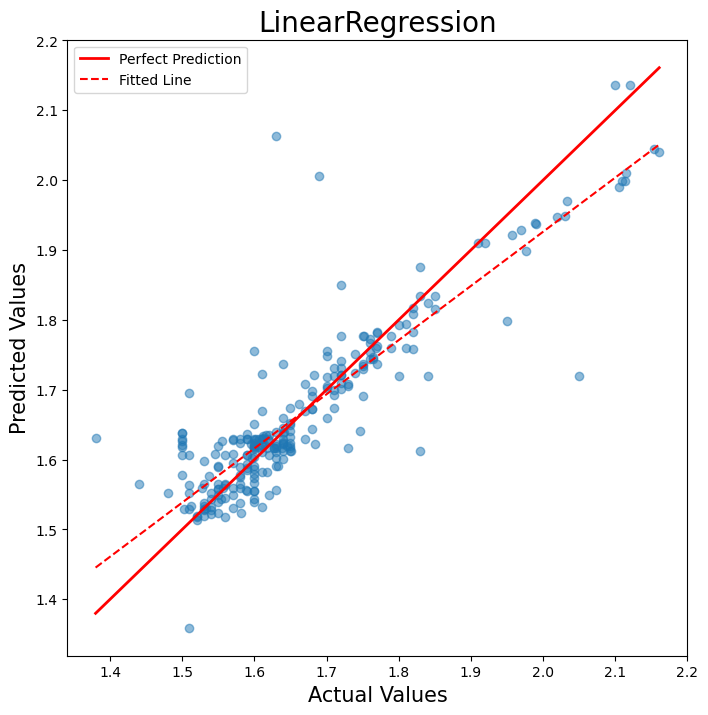

RMSE: 0.06687198009449123
Mean Absolute Error: 0.040434007832636544
Mean Squared Error: 0.004471861721758031
R²: 0.7767390355151801


In [23]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_squared_error
# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 训练线性回归模型
linear_reg = LinearRegression()
linear_reg.fit(X_train, y_train)

# 使用模型进行预测
y_pred = linear_reg.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred

# 绘制预测值和实际值之间的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red', lw=2, label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred, 1))(np.unique(y_test)), linestyle='--',color='red', label='Fitted Line')
plt.xlabel('Actual Values',fontsize=15)
plt.ylabel('Predicted Values',fontsize=15)
plt.title('LinearRegression',fontsize=20)
plt.legend(loc='upper left')
plt.show()

# 打印误差
# 计算均方根误差（RMSE）
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))
r2 = r2_score(y_test, y_pred)
print("R²:", r2)

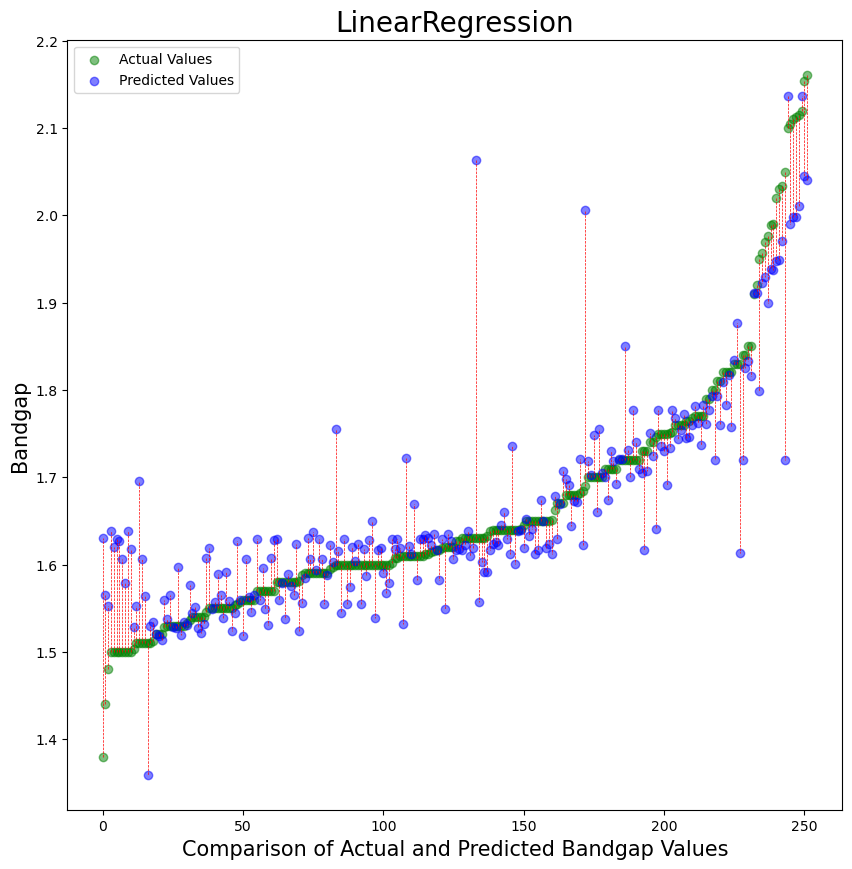

In [24]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
import numpy as np

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 训练线性回归模型
linear_reg = LinearRegression()
linear_reg.fit(X_train, y_train)

# 使用模型进行预测
y_pred = linear_reg.predict(X_test)
# 把预测值从NumPy数组转换为Pandas系列对象，并保留y_test的索引
y_pred_series = pd.Series(y_pred, index=y_test.index)

# 根据实际值排序，并存储排序后的索引
sorted_indices = y_test.sort_values().index

# 使用排序索引来排序实际值和预测值
y_test_sorted = y_test.loc[sorted_indices]
y_pred_sorted = y_pred_series.loc[sorted_indices]

# 确定横坐标
x_axis_sorted = np.arange(len(y_test_sorted))

# 绘制排序后的实际值和预测值的散点图
plt.figure(figsize=(10, 10))

plt.scatter(x_axis_sorted, y_test_sorted, color='green', label='Actual Values', alpha=0.5)

plt.scatter(x_axis_sorted, y_pred_sorted, color='blue', label='Predicted Values', alpha=0.5)
for i in range(len(x_axis_sorted)):
    plt.plot([x_axis_sorted[i], x_axis_sorted[i]], [y_test_sorted.iloc[i], y_pred_sorted.iloc[i]], color='red', linestyle='--', linewidth=0.5)
plt.xlabel('Comparison of Actual and Predicted Bandgap Values',fontsize=15)
plt.ylabel('Bandgap',fontsize=15)
plt.title('LinearRegression',fontsize=20)
plt.legend()
plt.show()

#### 岭回归

C:\Users\bobo\AppData\Local\Temp\ipykernel_9008\2019877325.py:30: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')


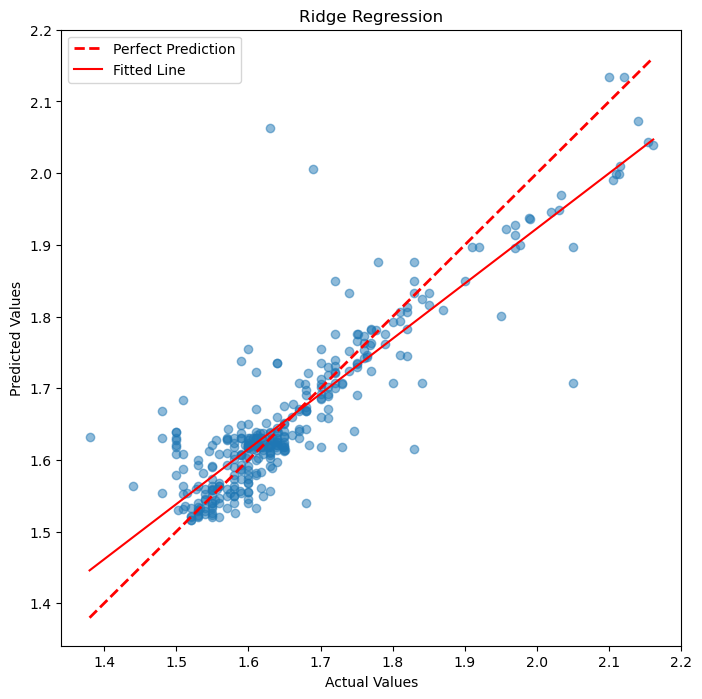

Mean Absolute Error: 0.03900419427032442
Mean Squared Error: 0.004015960140435788


In [62]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge
import matplotlib.pyplot as plt
import numpy as np

# 读取Excel文件
df=data[data['bandgap']<2.2]


# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

# 训练岭回归模型
ridge_reg = Ridge()
ridge_reg.fit(X_train, y_train)

# 使用模型进行预测
y_pred = ridge_reg.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred

# 绘制预测值和实际值之间的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red',linestyle='--', lw=2,label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred, 1))(np.unique(y_test)), color='red', label='Fitted Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Ridge Regression')
plt.legend(loc='upper left')
plt.show()

# 打印误差
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))


**lasso回归**

#### 决策树

C:\Users\bobo\AppData\Local\Temp\ipykernel_9008\3554630312.py:29: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')


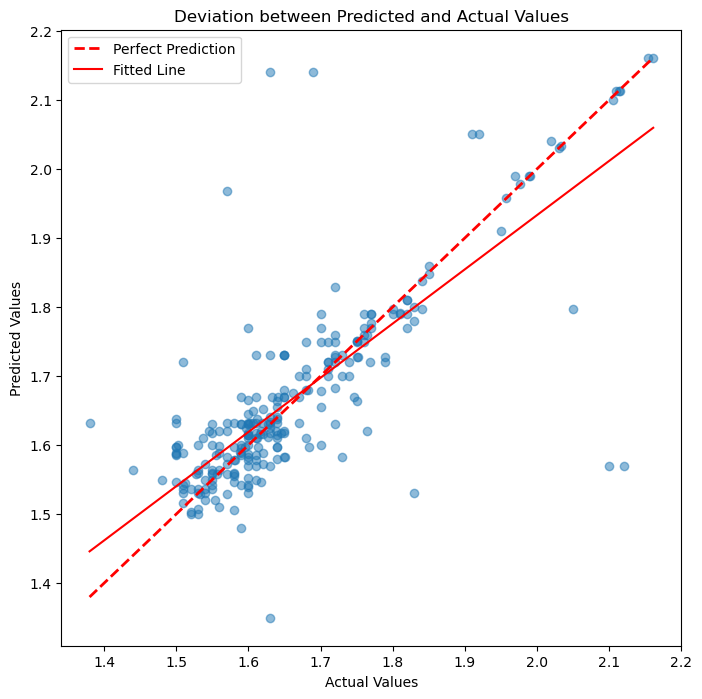

Mean Absolute Error: 0.04762993996743997
Mean Squared Error: 0.008351315901264571


In [34]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
import matplotlib.pyplot as plt
import numpy as np

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 训练决策树回归模型
tree_reg = DecisionTreeRegressor()
tree_reg.fit(X_train, y_train)

# 使用模型进行预测
y_pred = tree_reg.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred

# 绘制预测值和实际值之间的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red',linestyle='--', lw=2,label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred, 1))(np.unique(y_test)), color='red', label='Fitted Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Deviation between Predicted and Actual Values')
plt.legend(loc='upper left')
plt.show()

# 打印误差
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))

#### 随机森林

C:\Users\bobo\AppData\Local\Temp\ipykernel_9008\4036455058.py:29: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred, alpha=0.5, cmap='inferno')


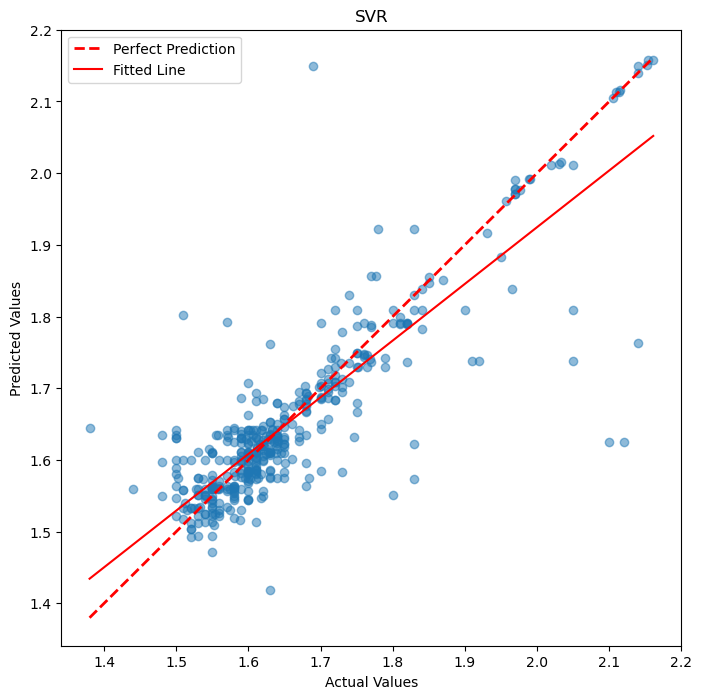

Mean Absolute Error: 0.04032137418465061
Mean Squared Error: 0.005288026564822765


In [55]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
import matplotlib.pyplot as plt
import numpy as np

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

# 训练随机森林回归模型
rf_reg = RandomForestRegressor()
rf_reg.fit(X_train, y_train)

# 使用模型进行预测
y_pred = rf_reg.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred

# 绘制预测值和实际值之间的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.5, cmap='inferno')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red',linestyle='--', lw=2,label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred, 1))(np.unique(y_test)), color='red', label='Fitted Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('SVR')
plt.legend(loc='upper left')
plt.show()

# 打印误差
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))

#### SVR

C:\Users\bobo\AppData\Local\Temp\ipykernel_9008\1166535502.py:29: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')


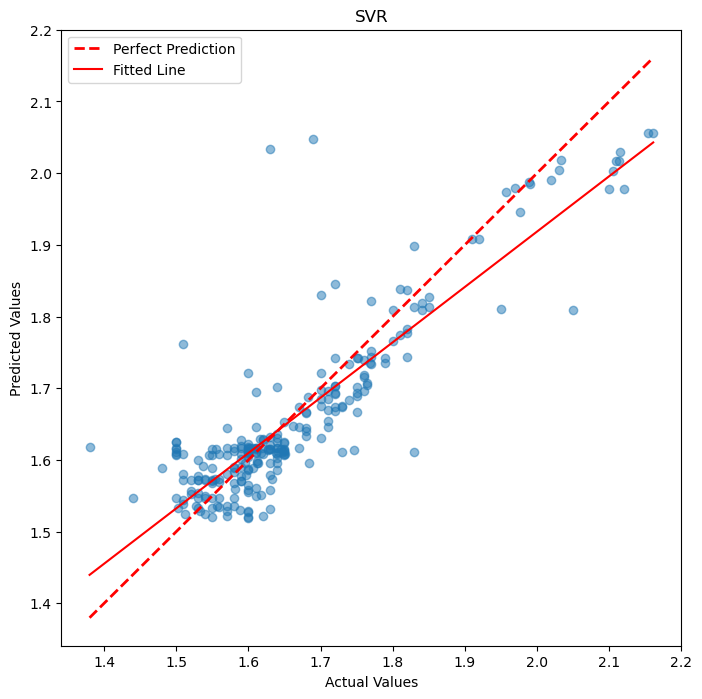

Mean Absolute Error: 0.04475668146458642
Mean Squared Error: 0.004559190627590293


In [59]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
import matplotlib.pyplot as plt
import numpy as np

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 训练支持向量机回归模型
svm_reg = SVR()
svm_reg.fit(X_train, y_train)

# 使用模型进行预测
y_pred = svm_reg.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred

# 绘制预测值和实际值之间的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red',linestyle='--', lw=2,label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred, 1))(np.unique(y_test)), color='red', label='Fitted Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('SVR')
plt.legend(loc='upper left')
plt.show()

# 打印误差
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))

#### adboot

C:\Users\bobo\AppData\Local\Temp\ipykernel_8408\1398139027.py:20: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')


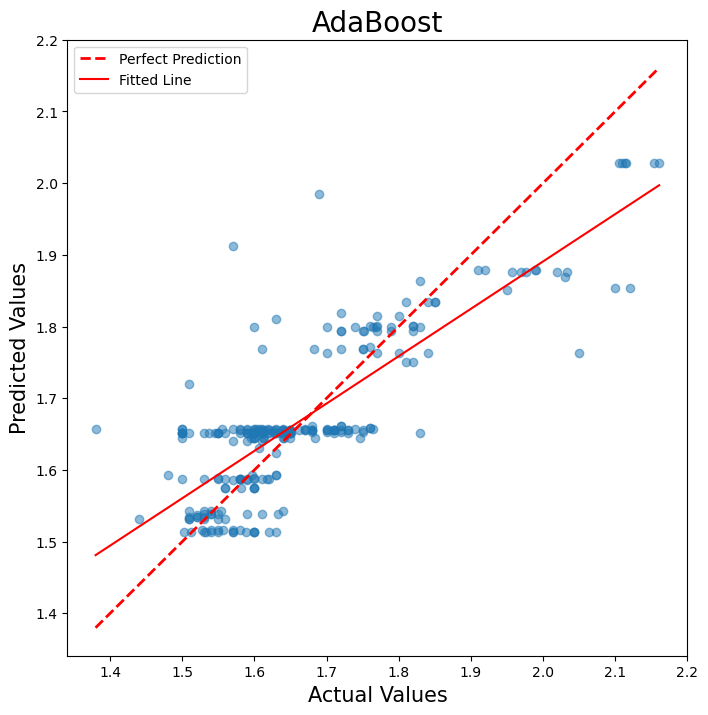

RMSE: 0.0798700682913789
Mean Absolute Error: 0.05703547362175557
Mean Squared Error: 0.006379227808869528
R²: 0.681512389717479


In [13]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostRegressor
import matplotlib.pyplot as plt
import numpy as np

df=data[data['bandgap']<2.2]
X = df.iloc[:, :5]
y = df.iloc[:, 5]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

ada_reg = AdaBoostRegressor()
ada_reg.fit(X_train, y_train)

y_pred = ada_reg.predict(X_test)

deviation = y_test - y_pred
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red',linestyle='--', lw=2,label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred, 1))(np.unique(y_test)), color='red', label='Fitted Line')
plt.xlabel('Actual Values',fontsize=15)
plt.ylabel('Predicted Values',fontsize=15)
plt.title('AdaBoost',fontsize=20)
plt.legend(loc='upper left')
plt.show()

rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))
r2 = r2_score(y_test, y_pred)
print("R²:", r2)

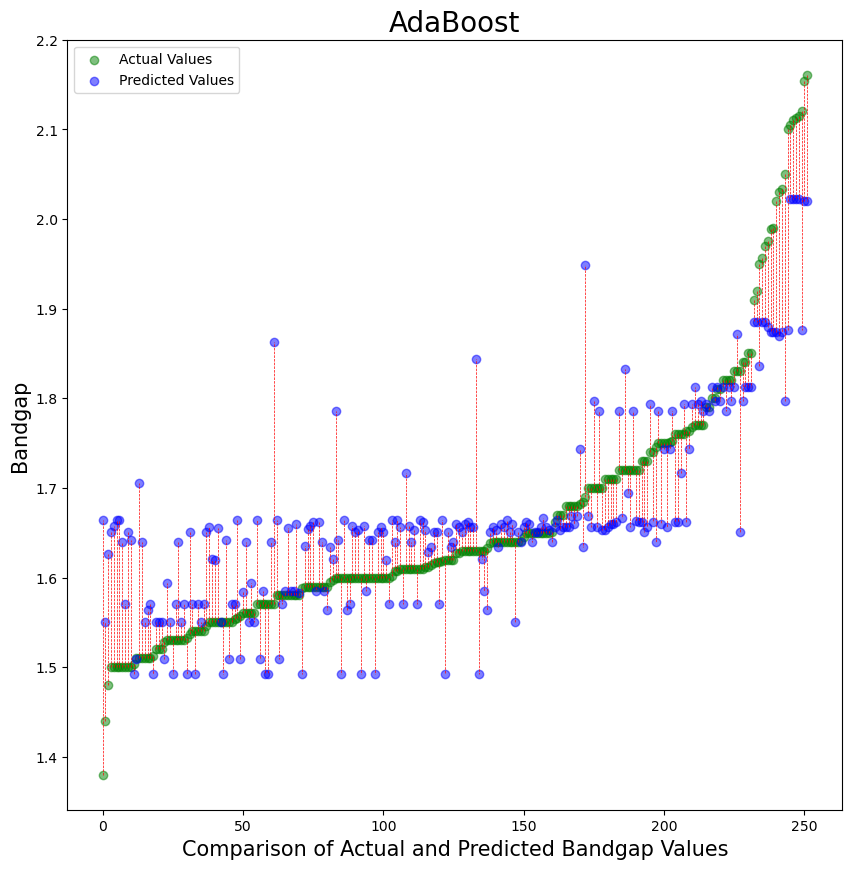

In [12]:

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostRegressor
import matplotlib.pyplot as plt
import numpy as np

df=data[data['bandgap']<2.2]
X = df.iloc[:, :5]
y = df.iloc[:, 5]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
ada_reg = AdaBoostRegressor()
ada_reg.fit(X_train, y_train)
y_pred = ada_reg.predict(X_test)
y_pred_series = pd.Series(y_pred, index=y_test.index)
sorted_indices = y_test.sort_values().index
y_test_sorted = y_test.loc[sorted_indices]
y_pred_sorted = y_pred_series.loc[sorted_indices]
x_axis_sorted = np.arange(len(y_test_sorted))

plt.figure(figsize=(10, 10))

plt.scatter(x_axis_sorted, y_test_sorted, color='green', label='Actual Values', alpha=0.5)

plt.scatter(x_axis_sorted, y_pred_sorted, color='blue', label='Predicted Values', alpha=0.5)
for i in range(len(x_axis_sorted)):
    plt.plot([x_axis_sorted[i], x_axis_sorted[i]], [y_test_sorted.iloc[i], y_pred_sorted.iloc[i]], color='red', linestyle='--', linewidth=0.5)
plt.xlabel('Comparison of Actual and Predicted Bandgap Values',fontsize=15)
plt.ylabel('Bandgap',fontsize=15)
plt.title('AdaBoost',fontsize=20)
plt.legend()
plt.show()

#### GBDT

C:\Users\bobo\AppData\Local\Temp\ipykernel_8408\1283434806.py:40: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')


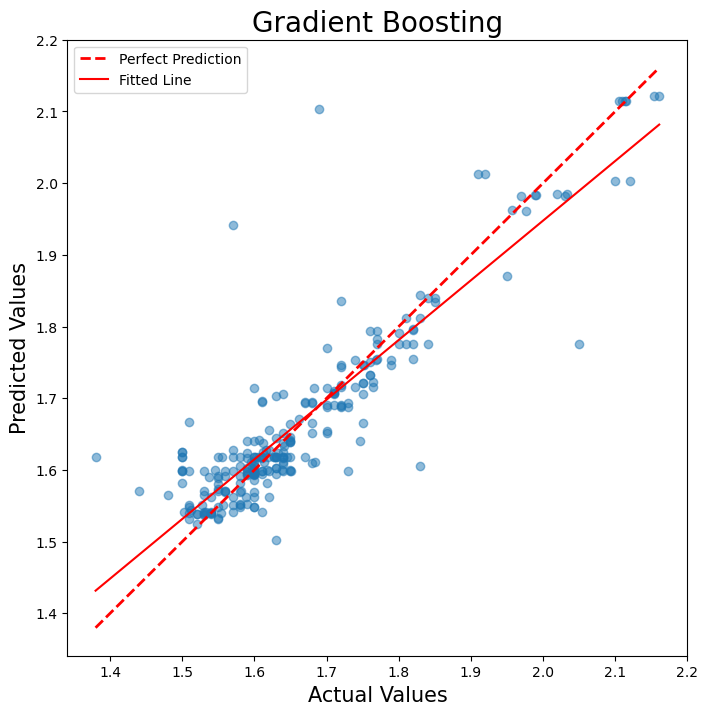

RMSE: 0.0621708768500972
Mean Absolute Error: 0.036962990928704864
Mean Squared Error: 0.003865217928309952
R²: 0.8070261702369358


In [15]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from skopt import BayesSearchCV
from skopt.space import Real, Integer
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 定义Gradient Boosting回归模型的超参数搜索空间
param_space = {
    'n_estimators': Integer(100, 500),
    'max_depth': Integer(3, 10),
    'learning_rate': Real(0.01, 0.3)
}

# 创建贝叶斯搜索优化器
gb_reg = GradientBoostingRegressor(random_state=42)
search = BayesSearchCV(gb_reg, param_space, n_iter=50, cv=5, scoring='neg_mean_squared_error', random_state=42)
search.fit(X_train, y_train)

# 使用最佳模型进行预测
y_pred = search.best_estimator_.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred

# 绘制预测值和实际值之间的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red',linestyle='--', lw=2,label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred, 1))(np.unique(y_test)), color='red', label='Fitted Line')
plt.xlabel('Actual Values',fontsize=15)
plt.ylabel('Predicted Values',fontsize=15)
plt.title('Gradient Boosting',fontsize=20)
plt.legend(loc='upper left')
plt.show()


# 计算均方根误差（RMSE）
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))
r2 = r2_score(y_test, y_pred)
print("R²:", r2)

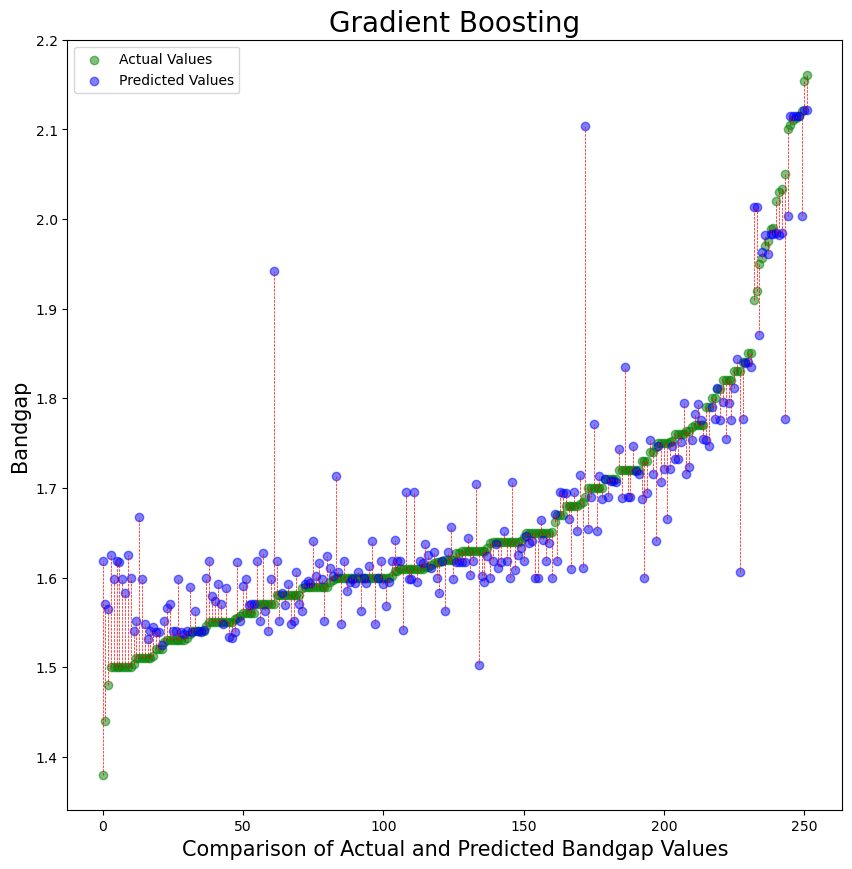

In [16]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from skopt import BayesSearchCV
from skopt.space import Real, Integer
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 定义Gradient Boosting回归模型的超参数搜索空间
param_space = {
    'n_estimators': Integer(100, 500),
    'max_depth': Integer(3, 10),
    'learning_rate': Real(0.01, 0.3)
}

# 创建贝叶斯搜索优化器
gb_reg = GradientBoostingRegressor(random_state=42)
search = BayesSearchCV(gb_reg, param_space, n_iter=50, cv=5, scoring='neg_mean_squared_error', random_state=42)
search.fit(X_train, y_train)

# 使用最佳模型进行预测
y_pred = search.best_estimator_.predict(X_test)
# 把预测值从NumPy数组转换为Pandas系列对象，并保留y_test的索引
y_pred_series = pd.Series(y_pred, index=y_test.index)

# 根据实际值排序，并存储排序后的索引
sorted_indices = y_test.sort_values().index

# 使用排序索引来排序实际值和预测值
y_test_sorted = y_test.loc[sorted_indices]
y_pred_sorted = y_pred_series.loc[sorted_indices]

# 确定横坐标
x_axis_sorted = np.arange(len(y_test_sorted))

# 绘制排序后的实际值和预测值的散点图
plt.figure(figsize=(10, 10))

plt.scatter(x_axis_sorted, y_test_sorted, color='green', label='Actual Values', alpha=0.5)

plt.scatter(x_axis_sorted, y_pred_sorted, color='blue', label='Predicted Values', alpha=0.5)
for i in range(len(x_axis_sorted)):
    plt.plot([x_axis_sorted[i], x_axis_sorted[i]], [y_test_sorted.iloc[i], y_pred_sorted.iloc[i]], color='red', linestyle='--', linewidth=0.5)
plt.xlabel('Comparison of Actual and Predicted Bandgap Values',fontsize=15)
plt.ylabel('Bandgap',fontsize=15)
plt.title('Gradient Boosting',fontsize=20)
plt.legend()
plt.show()

Best Parameters: OrderedDict([('C', 10.0), ('epsilon', 0.06221727744645019), ('kernel', 'rbf')])


C:\Users\bobo\AppData\Local\Temp\ipykernel_8408\2058115632.py:44: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred_best, alpha=0.5, cmap='inferno')


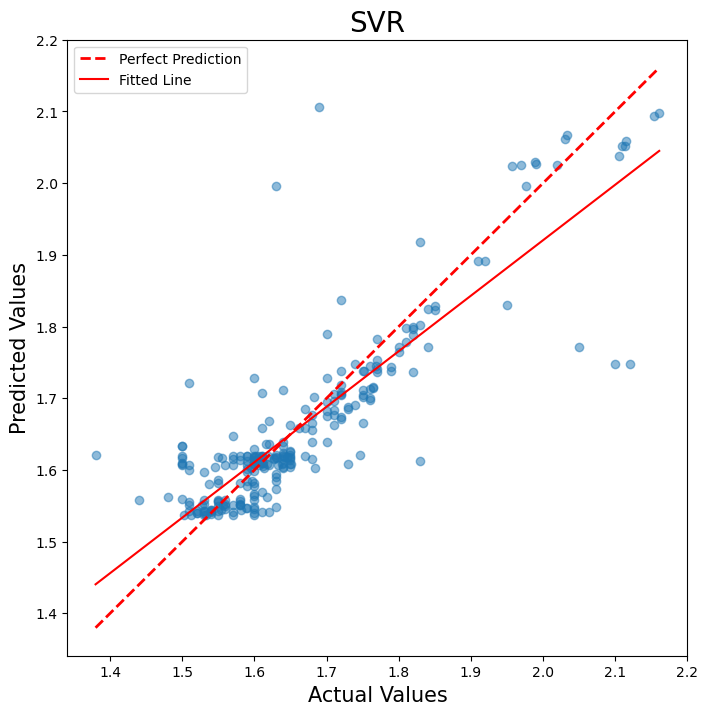

RMSE: 0.0621708768500972
Mean Absolute Error: 0.036962990928704864
Mean Squared Error: 0.003865217928309952
R²: 0.8070261702369358


In [17]:
import pandas as pd
from sklearn.model_selection import train_test_split
from skopt import BayesSearchCV
from sklearn.svm import SVR
import matplotlib.pyplot as plt
import numpy as np


df = data[data['bandgap'] < 2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df['bandgap']

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 定义要搜索的超参数范围
param_space = {
    'C': (0.1, 10.0),
    'epsilon': (0.001, 0.1),
    'kernel': ['linear', 'rbf']
}

# 初始化SVR模型
svm_reg = SVR()

# 使用BayesSearchCV进行贝叶斯优化
bayes_search = BayesSearchCV(svm_reg, param_space, n_iter=50, cv=5, random_state=42)
bayes_search.fit(X_train, y_train)

# 输出最佳参数组合
print("Best Parameters:", bayes_search.best_params_)

# 使用最佳参数组合的模型进行预测
best_svm_reg = bayes_search.best_estimator_
y_pred_best = best_svm_reg.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation_best = y_test - y_pred_best

# 绘制预测值和实际值之间的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred_best, alpha=0.5, cmap='inferno')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red', linestyle='--', lw=2, label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred_best, 1))(np.unique(y_test)), color='red', label='Fitted Line')
plt.xlabel('Actual Values',fontsize=15)
plt.ylabel('Predicted Values',fontsize=15)
plt.title('SVR',fontsize=20)
plt.legend(loc='upper left')
plt.show()

# 打印误差
# 计算均方根误差（RMSE）
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))
r2 = r2_score(y_test, y_pred)
print("R²:", r2)

Best Parameters: OrderedDict([('C', 10.0), ('epsilon', 0.06221727744645019), ('kernel', 'rbf')])


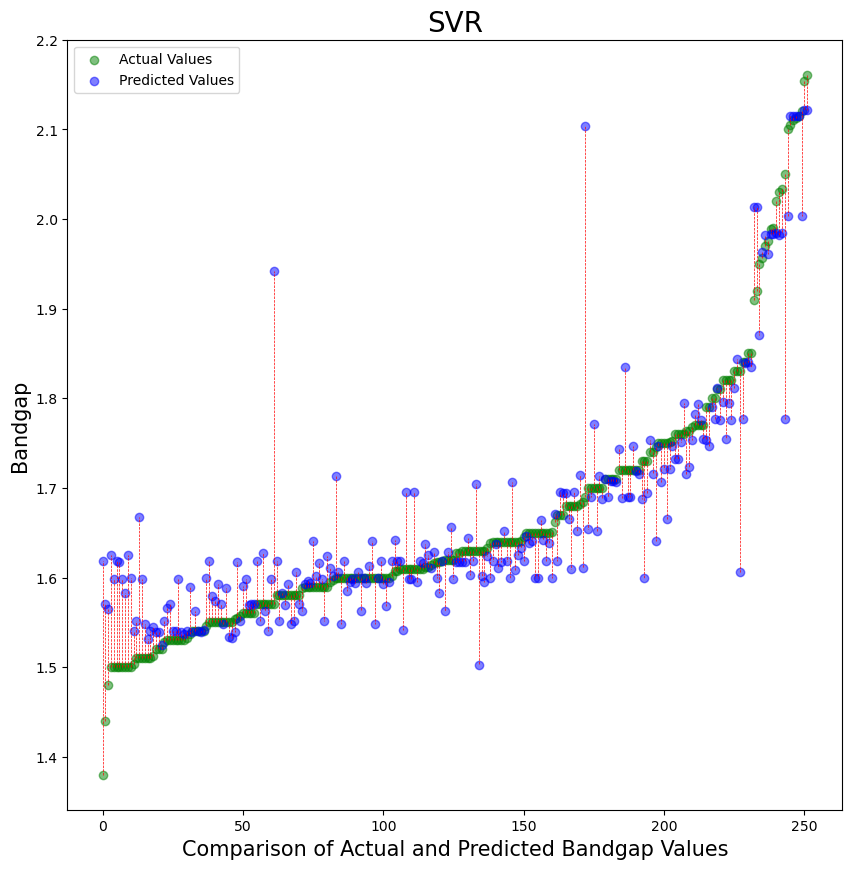

In [18]:
import pandas as pd
from sklearn.model_selection import train_test_split
from skopt import BayesSearchCV
from sklearn.svm import SVR
import matplotlib.pyplot as plt
import numpy as np


df = data[data['bandgap'] < 2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df['bandgap']

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 定义要搜索的超参数范围
param_space = {
    'C': (0.1, 10.0),
    'epsilon': (0.001, 0.1),
    'kernel': ['linear', 'rbf']
}

# 初始化SVR模型
svm_reg = SVR()

# 使用BayesSearchCV进行贝叶斯优化
bayes_search = BayesSearchCV(svm_reg, param_space, n_iter=50, cv=5, random_state=42)
bayes_search.fit(X_train, y_train)

# 输出最佳参数组合
print("Best Parameters:", bayes_search.best_params_)

# 使用最佳参数组合的模型进行预测
best_svm_reg = bayes_search.best_estimator_
y_pred_best = best_svm_reg.predict(X_test)
# 把预测值从NumPy数组转换为Pandas系列对象，并保留y_test的索引
y_pred_series = pd.Series(y_pred, index=y_test.index)

# 根据实际值排序，并存储排序后的索引
sorted_indices = y_test.sort_values().index

# 使用排序索引来排序实际值和预测值
y_test_sorted = y_test.loc[sorted_indices]
y_pred_sorted = y_pred_series.loc[sorted_indices]

# 确定横坐标
x_axis_sorted = np.arange(len(y_test_sorted))

# 绘制排序后的实际值和预测值的散点图
plt.figure(figsize=(10, 10))

plt.scatter(x_axis_sorted, y_test_sorted, color='green', label='Actual Values', alpha=0.5)

plt.scatter(x_axis_sorted, y_pred_sorted, color='blue', label='Predicted Values', alpha=0.5)
for i in range(len(x_axis_sorted)):
    plt.plot([x_axis_sorted[i], x_axis_sorted[i]], [y_test_sorted.iloc[i], y_pred_sorted.iloc[i]], color='red', linestyle='--', linewidth=0.5)
plt.xlabel('Comparison of Actual and Predicted Bandgap Values',fontsize=15)
plt.ylabel('Bandgap',fontsize=15)
plt.title('SVR',fontsize=20)
plt.legend()
plt.show()

#### catboot

0:	learn: 0.1317384	total: 208ms	remaining: 1m 20s
1:	learn: 0.1280148	total: 210ms	remaining: 40.4s
2:	learn: 0.1245355	total: 210ms	remaining: 26.9s
3:	learn: 0.1210542	total: 211ms	remaining: 20.2s
4:	learn: 0.1178013	total: 212ms	remaining: 16.2s
5:	learn: 0.1148850	total: 212ms	remaining: 13.5s
6:	learn: 0.1119503	total: 213ms	remaining: 11.6s
7:	learn: 0.1095336	total: 214ms	remaining: 10.1s
8:	learn: 0.1068231	total: 214ms	remaining: 9s
9:	learn: 0.1042531	total: 215ms	remaining: 8.11s
10:	learn: 0.1018783	total: 216ms	remaining: 7.37s
11:	learn: 0.0992517	total: 216ms	remaining: 6.76s
12:	learn: 0.0972216	total: 217ms	remaining: 6.24s
13:	learn: 0.0952009	total: 218ms	remaining: 5.8s
14:	learn: 0.0930950	total: 219ms	remaining: 5.42s
15:	learn: 0.0911702	total: 219ms	remaining: 5.08s
16:	learn: 0.0891701	total: 220ms	remaining: 4.79s
17:	learn: 0.0873826	total: 221ms	remaining: 4.53s
18:	learn: 0.0859657	total: 222ms	remaining: 4.29s
19:	learn: 0.0840726	total: 222ms	remaining:

C:\Users\bobo\AppData\Local\Temp\ipykernel_9768\2625638863.py:43: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred, alpha=0.5, cmap='black')


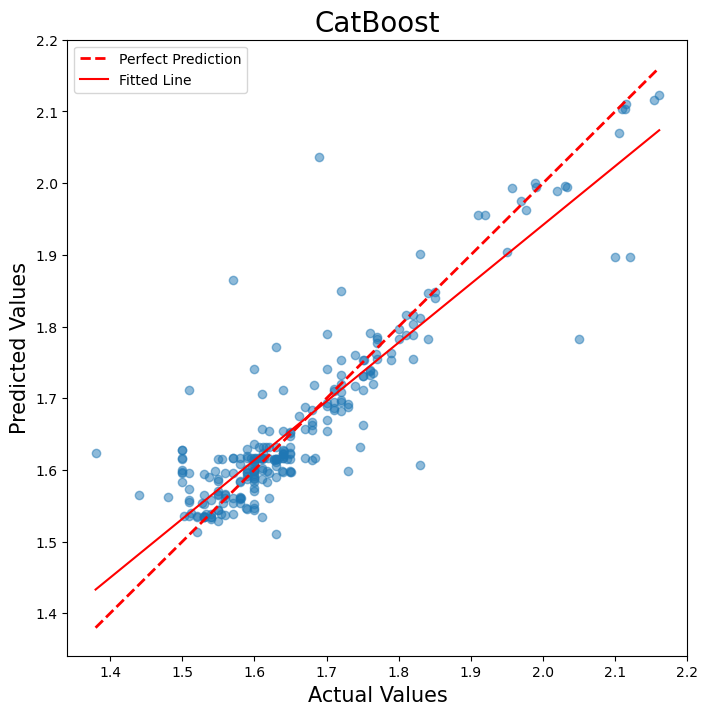

RMSE: 0.061492950199355426
Mean Absolute Error: 0.03696348982993125
Mean Squared Error: 0.0037813829242204066
R²: 0.8112116940825306


In [3]:
import pandas as pd
from sklearn.model_selection import train_test_split
from catboost import CatBoostRegressor
from skopt import BayesSearchCV
from skopt.space import Real, Integer
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 定义CatBoost回归模型的超参数搜索空间
param_space = {
    'n_estimators': Integer(200, 400),
    'max_depth': Integer(3, 6),
    'learning_rate': Real(0.01, 0.1)
}

# 创建贝叶斯搜索优化器
cb_reg = CatBoostRegressor(random_state=42)
search = BayesSearchCV(cb_reg, param_space, n_iter=50, cv=5, scoring='neg_mean_squared_error', random_state=42)
search.fit(X_train, y_train)
from joblib import dump

# 保存模型
dump(search.best_estimator_, 'catboost_model.joblib')
# 使用最佳模型进行预测
y_pred = search.best_estimator_.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred

# 绘制预测值和实际值之间的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.5, cmap='black')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red',linestyle='--', lw=2,label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred, 1))(np.unique(y_test)), color='red', label='Fitted Line')
plt.xlabel('Actual Values',fontsize=15)
plt.ylabel('Predicted Values',fontsize=15)
plt.title('CatBoost',fontsize=20)
plt.legend(loc='upper left')
plt.show()

# 打印误差
# 计算均方根误差（RMSE）
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))
r2 = r2_score(y_test, y_pred)
print("R²:", r2)

0:	learn: 0.1317384	total: 1.56ms	remaining: 603ms
1:	learn: 0.1280148	total: 2.96ms	remaining: 571ms
2:	learn: 0.1245355	total: 3.98ms	remaining: 510ms
3:	learn: 0.1210542	total: 4.86ms	remaining: 465ms
4:	learn: 0.1178013	total: 5.74ms	remaining: 439ms
5:	learn: 0.1148850	total: 6.7ms	remaining: 425ms
6:	learn: 0.1119503	total: 7.69ms	remaining: 417ms
7:	learn: 0.1095336	total: 8.63ms	remaining: 409ms
8:	learn: 0.1068231	total: 9.47ms	remaining: 398ms
9:	learn: 0.1042531	total: 10.3ms	remaining: 389ms
10:	learn: 0.1018783	total: 11.1ms	remaining: 379ms
11:	learn: 0.0992517	total: 11.9ms	remaining: 371ms
12:	learn: 0.0972216	total: 12.6ms	remaining: 364ms
13:	learn: 0.0952009	total: 13.5ms	remaining: 359ms
14:	learn: 0.0930950	total: 14.2ms	remaining: 351ms
15:	learn: 0.0911702	total: 14.8ms	remaining: 343ms
16:	learn: 0.0891701	total: 15.5ms	remaining: 338ms
17:	learn: 0.0873826	total: 16.1ms	remaining: 331ms
18:	learn: 0.0859657	total: 16.8ms	remaining: 326ms
19:	learn: 0.0840726	to

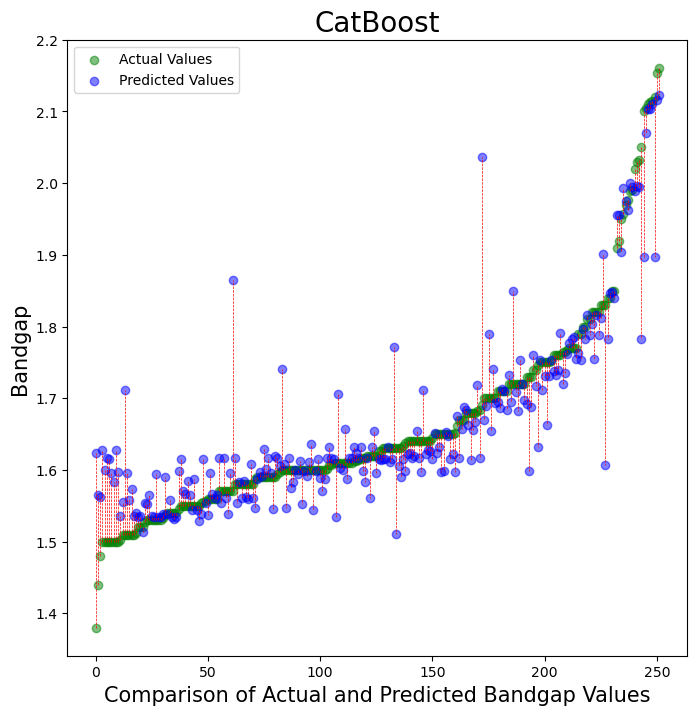

In [20]:
import pandas as pd
from sklearn.model_selection import train_test_split
from catboost import CatBoostRegressor
from skopt import BayesSearchCV
from skopt.space import Real, Integer
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 定义CatBoost回归模型的超参数搜索空间
param_space = {
    'n_estimators': Integer(200, 400),
    'max_depth': Integer(3, 6),
    'learning_rate': Real(0.01, 0.1)
}

# 创建贝叶斯搜索优化器
cb_reg = CatBoostRegressor(random_state=42)
search = BayesSearchCV(cb_reg, param_space, n_iter=50, cv=5, scoring='neg_mean_squared_error', random_state=42)
search.fit(X_train, y_train)

# 使用最佳模型进行预测
y_pred = search.best_estimator_.predict(X_test)
# 把预测值从NumPy数组转换为Pandas系列对象，并保留y_test的索引
y_pred_series = pd.Series(y_pred, index=y_test.index)

# 根据实际值排序，并存储排序后的索引
sorted_indices = y_test.sort_values().index

# 使用排序索引来排序实际值和预测值
y_test_sorted = y_test.loc[sorted_indices]
y_pred_sorted = y_pred_series.loc[sorted_indices]

# 确定横坐标
x_axis_sorted = np.arange(len(y_test_sorted))

# 绘制排序后的实际值和预测值的散点图
plt.figure(figsize=(8, 8))

plt.scatter(x_axis_sorted, y_test_sorted, color='green', label='Actual Values', alpha=0.5)

plt.scatter(x_axis_sorted, y_pred_sorted, color='blue', label='Predicted Values', alpha=0.5)
for i in range(len(x_axis_sorted)):
    plt.plot([x_axis_sorted[i], x_axis_sorted[i]], [y_test_sorted.iloc[i], y_pred_sorted.iloc[i]], color='red', linestyle='--', linewidth=0.5)
plt.xlabel('Comparison of Actual and Predicted Bandgap Values',fontsize=15)
plt.ylabel('Bandgap',fontsize=15)
plt.title('CatBoost',fontsize=20)
plt.legend()
plt.show()

NN

C:\Users\bobo\AppData\Local\Temp\ipykernel_8408\644831660.py:29: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')


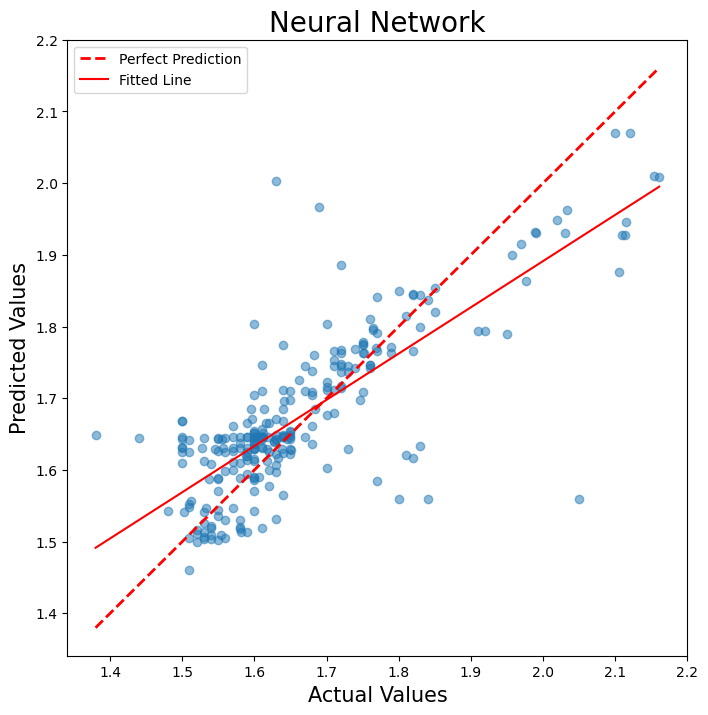

RMSE: 0.08637955448742647
Mean Absolute Error: 0.05840340674428753
Mean Squared Error: 0.007461427433446278
R²: 0.6274827825915392


In [21]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPRegressor
import matplotlib.pyplot as plt
import numpy as np

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 训练神经网络回归模型
nn_reg = MLPRegressor(hidden_layer_sizes=(10,), activation='relu', solver='adam', random_state=42)
nn_reg.fit(X_train, y_train)

# 使用模型进行预测
y_pred = nn_reg.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred

# 绘制预测值和实际值之间的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.5, cmap='Blues')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'red',linestyle='--', lw=2,label='Perfect Prediction')
plt.plot(np.unique(y_test), np.poly1d(np.polyfit(y_test, y_pred, 1))(np.unique(y_test)), color='red', label='Fitted Line')
plt.xlabel('Actual Values',fontsize=15)
plt.ylabel('Predicted Values',fontsize=15)
plt.title('Neural Network',fontsize=20)
plt.legend(loc='upper left')
plt.show()

# 打印误差
# 计算均方根误差（RMSE）
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))
r2 = r2_score(y_test, y_pred)
print("R²:", r2)

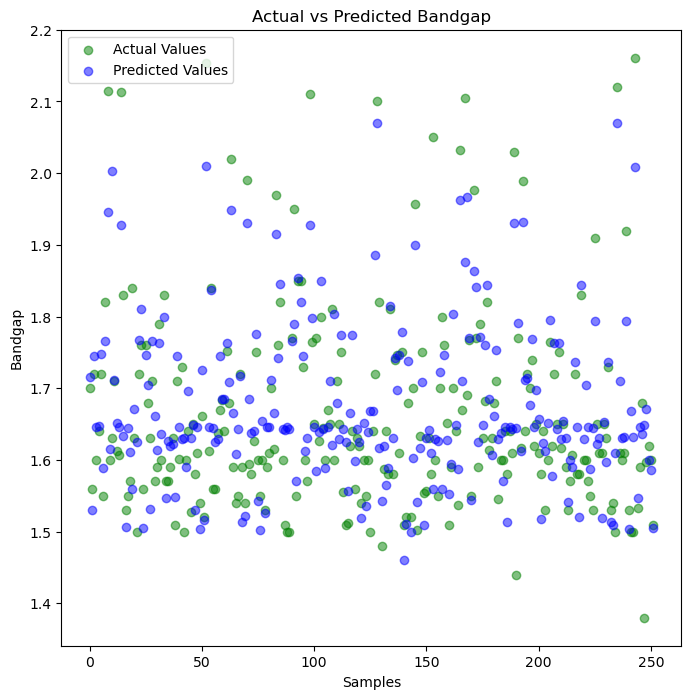

Mean Absolute Error: 0.05840340674428753
Mean Squared Error: 0.007461427433446278


In [6]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPRegressor
import matplotlib.pyplot as plt
import numpy as np

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 训练神经网络回归模型
nn_reg = MLPRegressor(hidden_layer_sizes=(10,), activation='relu', solver='adam', random_state=42)
nn_reg.fit(X_train, y_train)

# 使用模型进行预测
y_pred = nn_reg.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred

# 绘制预测值和实际值
# 针对实际值和预测值创建横坐标
x_actual = np.arange(len(y_test))
x_pred = np.arange(len(y_pred))

# 绘制实际值和预测值
plt.figure(figsize=(8, 8))

# 实际值用绿色表示
plt.scatter(x_actual, y_test, color='green', label='Actual Values', alpha=0.5)

# 预测值用蓝色表示
plt.scatter(x_pred, y_pred, color='blue', label='Predicted Values', alpha=0.5)

# 添加轴标签和图标题
plt.xlabel('Samples')
plt.ylabel('Bandgap')
plt.title('Actual vs Predicted Bandgap')

# 添加图例
plt.legend(loc='upper left')

# 显示图形
plt.show()
# 打印误差
print("Mean Absolute Error:", np.mean(np.abs(deviation)))
print("Mean Squared Error:", np.mean(deviation**2))

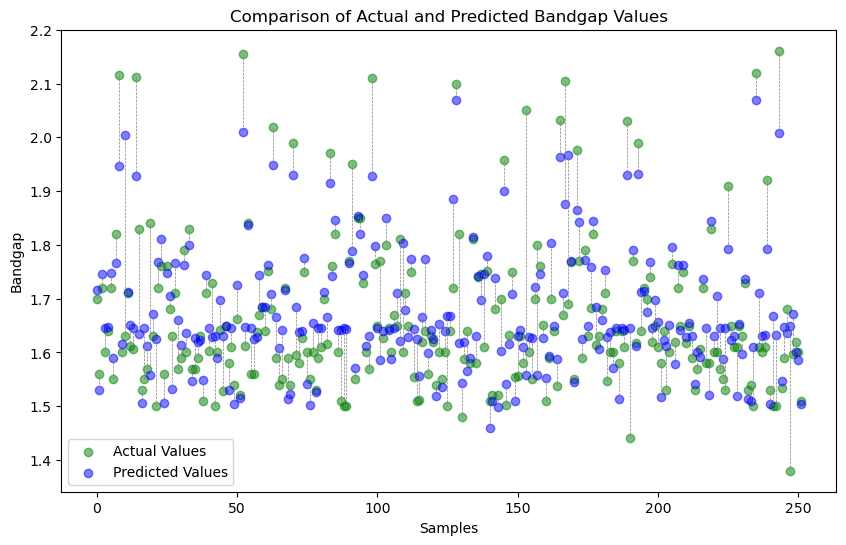

In [7]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPRegressor
import matplotlib.pyplot as plt
import numpy as np

# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 训练神经网络回归模型
nn_reg = MLPRegressor(hidden_layer_sizes=(10,), activation='relu', solver='adam', random_state=42)
nn_reg.fit(X_train, y_train)

# 使用模型进行预测
y_pred = nn_reg.predict(X_test)

# 计算预测值和实际值之间的偏差
deviation = y_test - y_pred
# 确定横坐标
x_axis = np.arange(len(y_test))

# 绘制实际值和预测值的散点图
plt.figure(figsize=(10, 6))

# 实际值用绿色表示
plt.scatter(x_axis, y_test, color='green', label='Actual Values', alpha=0.5)

# 预测值用蓝色表示
plt.scatter(x_axis, y_pred, color='blue', label='Predicted Values', alpha=0.5)

# 添加连接线
for i in range(len(x_axis)):
    plt.plot([x_axis[i], x_axis[i]], [y_test.iloc[i], y_pred[i]], color='grey', linestyle='--', linewidth=0.5)

# 添加轴标签和图标题
plt.xlabel('Samples')
plt.ylabel('Bandgap')
plt.title('Comparison of Actual and Predicted Bandgap Values')

# 添加图例
plt.legend()

# 显示图形
plt.show()

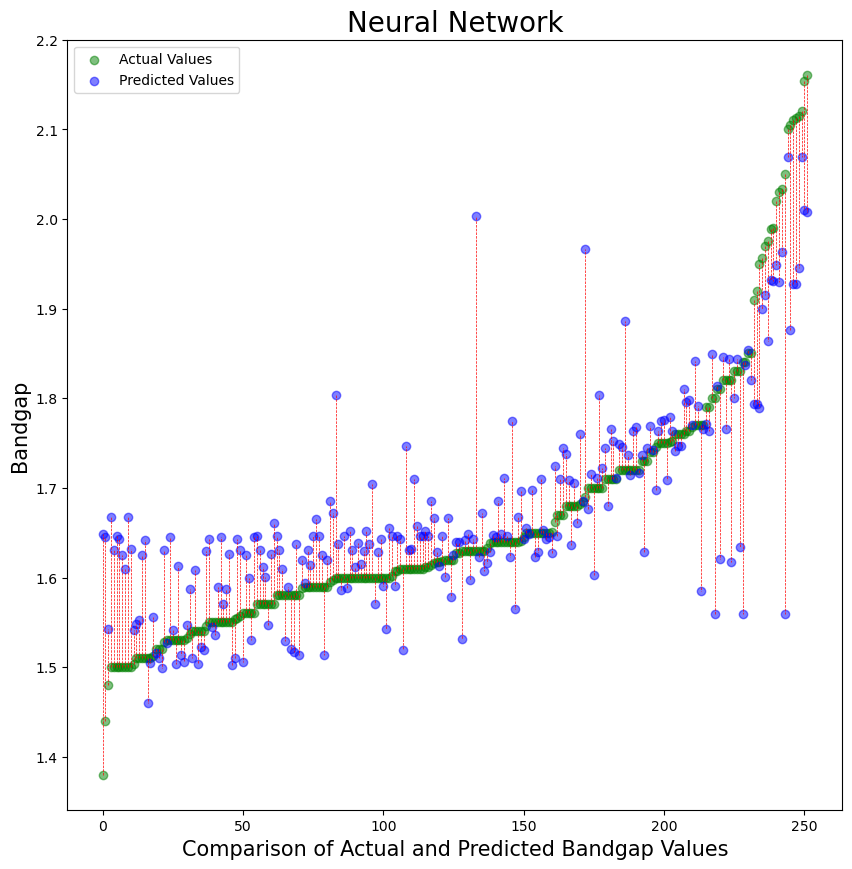

In [22]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPRegressor
import matplotlib.pyplot as plt
import numpy as np
# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 训练神经网络回归模型
nn_reg = MLPRegressor(hidden_layer_sizes=(10,), activation='relu', solver='adam', random_state=42)
nn_reg.fit(X_train, y_train)


# 这是您已经有的代码部分
# ...

# 使用模型进行预测
y_pred = nn_reg.predict(X_test)

# 把预测值从NumPy数组转换为Pandas系列对象，并保留y_test的索引
y_pred_series = pd.Series(y_pred, index=y_test.index)

# 根据实际值排序，并存储排序后的索引
sorted_indices = y_test.sort_values().index

# 使用排序索引来排序实际值和预测值
y_test_sorted = y_test.loc[sorted_indices]
y_pred_sorted = y_pred_series.loc[sorted_indices]

# 确定横坐标
x_axis_sorted = np.arange(len(y_test_sorted))

# 绘制排序后的实际值和预测值的散点图
plt.figure(figsize=(10, 10))

plt.scatter(x_axis_sorted, y_test_sorted, color='green', label='Actual Values', alpha=0.5)

plt.scatter(x_axis_sorted, y_pred_sorted, color='blue', label='Predicted Values', alpha=0.5)
for i in range(len(x_axis_sorted)):
    plt.plot([x_axis_sorted[i], x_axis_sorted[i]], [y_test_sorted.iloc[i], y_pred_sorted.iloc[i]], color='red', linestyle='--', linewidth=0.5)
plt.xlabel('Comparison of Actual and Predicted Bandgap Values',fontsize=15)
plt.ylabel('Bandgap',fontsize=15)
plt.title('Neural Network',fontsize=20)
plt.legend()
plt.show()

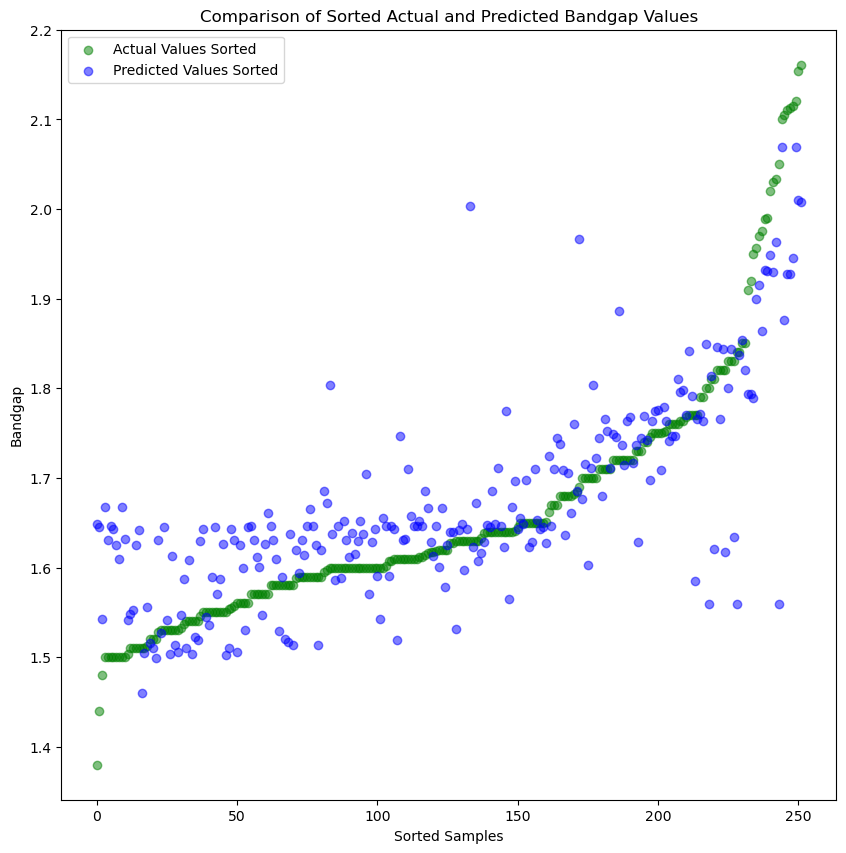

In [12]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPRegressor
import matplotlib.pyplot as plt
import numpy as np
# 读取Excel文件
df=data[data['bandgap']<2.2]

# 分割特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 训练神经网络回归模型
nn_reg = MLPRegressor(hidden_layer_sizes=(10,), activation='relu', solver='adam', random_state=42)
nn_reg.fit(X_train, y_train)


# 这是您已经有的代码部分
# ...

# 使用模型进行预测
y_pred = nn_reg.predict(X_test)

# 把预测值从NumPy数组转换为Pandas系列对象，并保留y_test的索引
y_pred_series = pd.Series(y_pred, index=y_test.index)

# 根据实际值排序，并存储排序后的索引
sorted_indices = y_test.sort_values().index

# 使用排序索引来排序实际值和预测值
y_test_sorted = y_test.loc[sorted_indices]
y_pred_sorted = y_pred_series.loc[sorted_indices]

# 确定横坐标
x_axis_sorted = np.arange(len(y_test_sorted))

# 绘制排序后的实际值和预测值的散点图
plt.figure(figsize=(10, 10))

plt.scatter(x_axis_sorted, y_test_sorted, color='green', label='Actual Values Sorted', alpha=0.5)

plt.scatter(x_axis_sorted, y_pred_sorted, color='blue', label='Predicted Values Sorted', alpha=0.5)
# for i in range(len(x_axis_sorted)):
#     plt.plot([x_axis_sorted[i], x_axis_sorted[i]], [y_test_sorted.iloc[i], y_pred_sorted.iloc[i]], color='grey', linestyle='--', linewidth=0.5)
plt.xlabel('Sorted Samples')
plt.ylabel('Bandgap')
plt.title('Comparison of Sorted Actual and Predicted Bandgap Values')
plt.legend()
plt.show()

In [58]:
import openpyxl
workbook = openpyxl.load_workbook('datasets/bandgap_datasets.xlsx')
sheet = workbook['Sheet1']
perovskite_col = None
for col in range(1, sheet.max_column + 1):
    if sheet.cell(row=1, column=col).value == 'Perovskite':
        perovskite_col = col
        break
cs_col = perovskite_col + 1
sheet.insert_cols(cs_col)
sheet.cell(row=1, column=cs_col, value='Br')
for row in range(2, sheet.max_row + 1):
    perovskite_value = sheet.cell(row=row, column=perovskite_col).value
    if perovskite_value is None:
        sheet.cell(row=row, column=cs_col, value=0)
    else:
        cs_index = perovskite_value.find('Br')
        if cs_index == -1:
            sheet.cell(row=row, column=cs_col, value=0)
        else:
            next_letter_index = cs_index + 2
            while next_letter_index < len(perovskite_value) and not perovskite_value[next_letter_index].isalpha():
                next_letter_index += 1
            cs_value = perovskite_value[cs_index:next_letter_index]
            sheet.cell(row=row, column=cs_col, value=cs_value)
workbook.save('datasets/bandgap_datasets.xlsx')

FileNotFoundError: [Errno 2] No such file or directory: 'datasets/bandgap_datasets.xlsx'

In [ ]:
df = pd.read_excel('datasets/bandgap_datasets.xlsx')
df.drop(columns=['Perovskite'], inplace=True)
df.to_excel('datasets/bandgap_datasets.xlsx', index=False)
df.columns

Index(['Br', 'I', 'MA', 'FA', 'Cs', 'bandgap'], dtype='object')

In [ ]:

df = pd.read_excel('datasets/bandgap_datasets.xlsx')
first_five_cols = df.iloc[:, :5]
first_five_cols = first_five_cols.iloc[:, ::-1]
df = pd.concat([first_five_cols, df.iloc[:, 5:]], axis=1)
df.to_excel('datasets/bandgap_datasets.xlsx', index=False)

In [ ]:
import re
df = pd.read_excel('datasets/output_file.xlsx')
df['Br'] = df['Br'].apply(lambda x: re.sub(r'[^\d.]+', '', str(x)) if re.search(r'\d', str(x)) else '1')

df.to_excel('datasets/output_file.xlsx', index=False)

In [ ]:
df = df.apply(pd.to_numeric, errors='coerce')

In [ ]:

df['condition1'] = df['Cs'] + df['FA'] + df['MA'] == 1
df['condition2'] = df['I'] + df['Br'] == 3

df = df[df['condition1'] & df['condition2']]

df = df.drop(['condition1', 'condition2'], axis=1)

df.to_excel('datasets/bandgap_datasets.xlsx', index=False)

In [ ]:
import pandas as pd

# 读取 Excel 文件
df = pd.read_excel('datasets/bandgaps.xlsx')

# 将 'Cs' 列和 'I' 列的每行数值都乘以3
df['Br'] = df['Br'] * 3
df['I'] = df['I'] * 3

# 保存处理后的数据到新的 Excel 文件
df.to_excel('datasets/bandgaps.xlsx', index=False)

In [ ]:
df=pd.read_excel("datasets/bandgap_datasets.xlsx")
df.info()

Index(['Cs', 'FA', 'MA', 'I', 'Br', 'bandgap'], dtype='object')

In [ ]:
df['bandgap']=df['bandgap'].astype("float64")

In [ ]:

grouped = df.groupby(df.columns[:5].tolist())

# 计算第六列数据的平均值
result = grouped[df.columns[5]].mean().reset_index()

result.shape

(481, 6)

In [ ]:
result.to_excel("datasets/bandgaps.xlsx",index=False)

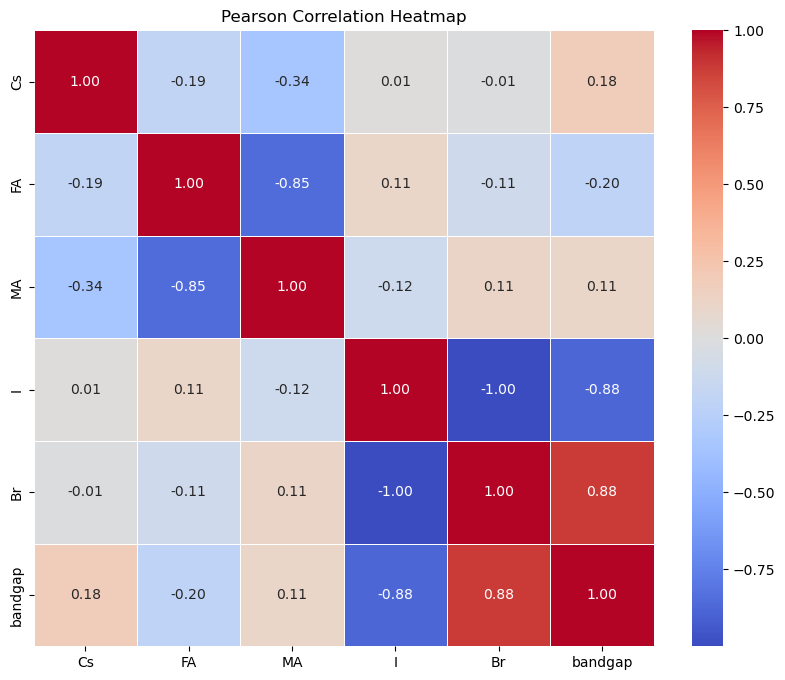

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

df = result
# 计算偏相关系数矩阵
corr_matrix = df.corr(method='pearson')

# 使用seaborn绘制热图
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title("Pearson Correlation Heatmap")
plt.show()

In [ ]:
features = data.iloc[:, :6]
correlation_matrix = features.corr()
partial_correlation_matrix = pd.DataFrame(index=correlation_matrix.columns, columns=correlation_matrix.columns)

for i, feature1 in enumerate(correlation_matrix.columns):
    for j, feature2 in enumerate(correlation_matrix.columns):
        if i == j:
            partial_correlation_matrix.iloc[i, j] = 1.0
        else:
            data_partial = features[[feature1, feature2]]
            mask = ~data_partial.isnull().any(axis=1)
            partial_correlation_matrix.iloc[i, j] = stats.pearsonr(data_partial[mask][feature1], data_partial[mask][feature2])[0]

print("Partial Correlation Matrix:")
print(partial_correlation_matrix)


Partial Correlation Matrix:
                   Cs        FA        MA         I        Br Bandgap(eV)
Cs                1.0 -0.349207 -0.406929 -0.256663  0.256068    0.428095
FA          -0.349207       1.0 -0.707812  0.250226 -0.249162   -0.357428
MA          -0.406929 -0.707812       1.0 -0.058091  0.057567    0.034718
I           -0.256663  0.250226 -0.058091       1.0  -0.99956   -0.905838
Br           0.256068 -0.249162  0.057567  -0.99956       1.0    0.904876
Bandgap(eV)  0.428095 -0.357428  0.034718 -0.905838  0.904876         1.0


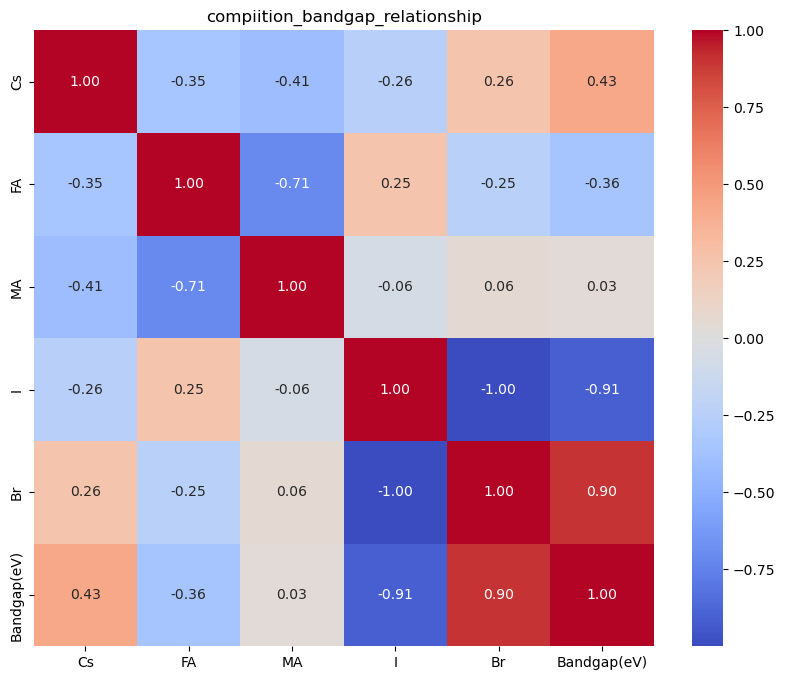

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
df = pd.read_excel('bandgap.xlsx')
features = df.iloc[:, :6]
correlation_matrix = features.corr(method='pearson')
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('compiition_bandgap_relationship')
plt.show()


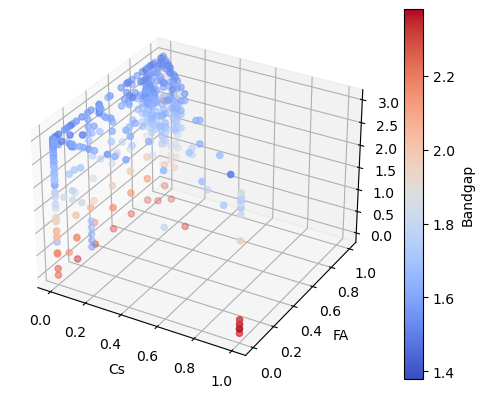

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
df = pd.read_excel('datasets/bandgaps.xlsx')
features = df.iloc[:, [0, 1, 3]]
target = df.iloc[:, 5]
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(features.iloc[:, 0], features.iloc[:, 1], features.iloc[:, 2], c=target, cmap='coolwarm')
ax.set_xlabel('Cs')
ax.set_ylabel('FA')
ax.set_zlabel('I')
plt.colorbar(sc, label='Bandgap')
plt.show()

# ax.contour(X, Y, Z, zdir='z', offset=-100, cmap='coolwarm')
# ax.contour(X, Y, Z, zdir='x', offset=-40, cmap='coolwarm')
# ax.contour(X, Y, Z, zdir='y', offset=40, cmap='coolwarm')

# ax.set(xlim=(-40, 40), ylim=(-40, 40), zlim=(-100, 100),
#        xlabel='X', ylabel='Y', zlabel='Z')

# plt.show()

#### 线性回归

Root Mean Squared Error (RMSE): 0.08023


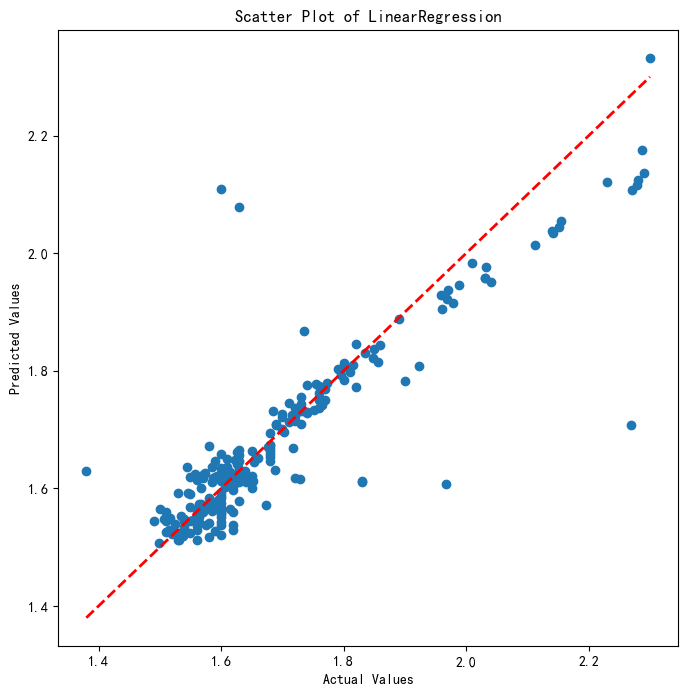

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

data =pd.read_excel('datasets/bandgaps.xlsx')


X = data.iloc[:, :5].values
y = data.iloc[:, 5].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=10)

model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
print(f"Root Mean Squared Error (RMSE): {rmse:.5f}")

plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'r--', linewidth=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Scatter Plot of LinearRegression')
plt.show()

In [ ]:
data['bandgap']=data['bandgap'].astype('float64')
data.to_excel("datasets/bandgap_datasets.xlsx",index=False)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 863 entries, 0 to 862
Data columns (total 6 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Cs       863 non-null    float64
 1   FA       863 non-null    float64
 2   MA       863 non-null    float64
 3   I        863 non-null    float64
 4   Br       863 non-null    float64
 5   bandgap  863 non-null    float64
dtypes: float64(6)
memory usage: 40.6 KB


#### 多项式回归

Mean Squared Error: 0.08085525359185147


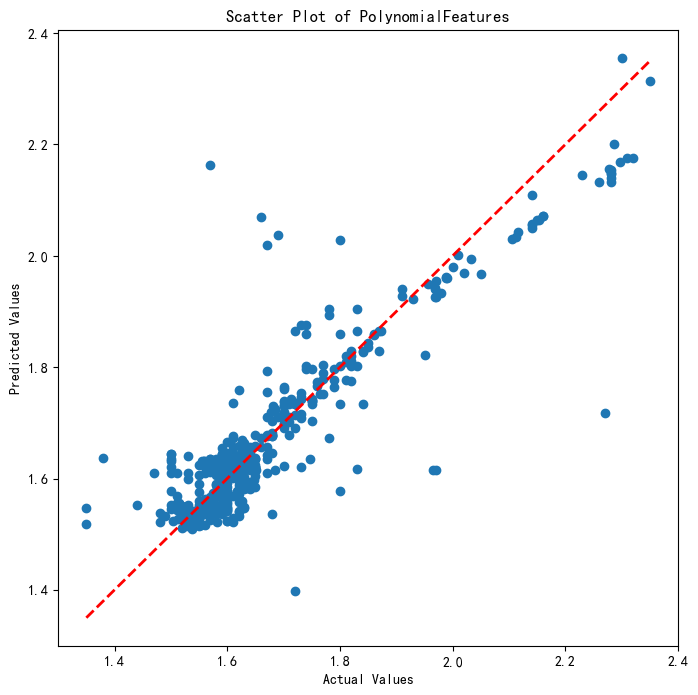

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# 读取Excel表格数据
data = pd.read_excel('datasets/bandgap_datasets.xlsx')

# 提取输入特征和目标值
X = data.iloc[:, :5]
y = data.iloc[:, 5]

# 使用多项式特征转换
poly = PolynomialFeatures(degree=1)
X_poly = poly.fit_transform(X)

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_poly, y, test_size=0.5, random_state=42)

# 创建线性回归模型
model = LinearRegression()

# 训练模型
model.fit(X_train, y_train)

# 预测
y_pred = model.predict(X_test)

# 计算均方根误差
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print("Mean Squared Error:", rmse)
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'r--', linewidth=2)
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Scatter Plot of PolynomialFeatures")
plt.show()

#### 岭回归

均方误差（Mean Squared Error）: 0.0020094281268687305


C:\Users\Administrator\AppData\Local\Temp\ipykernel_4248\2394864783.py:27: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=3, color='red')


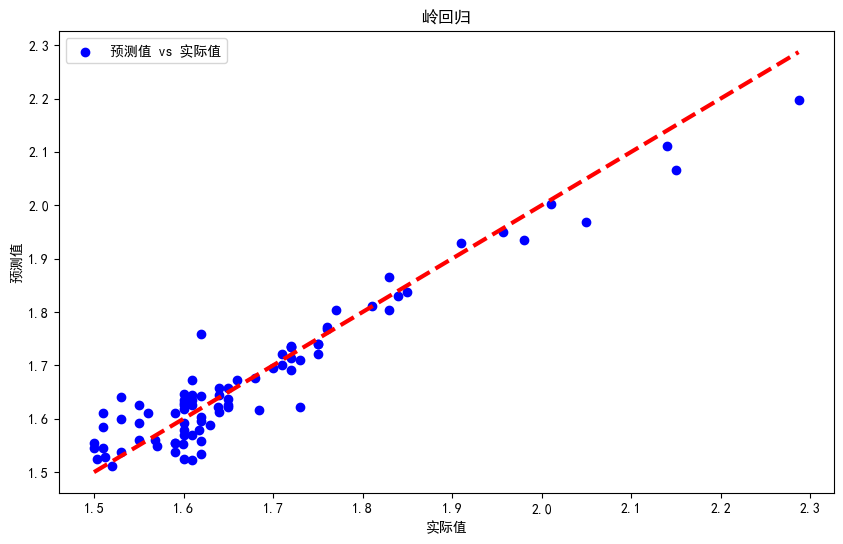

In [ ]:

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error
df = pd.read_excel('datasets/bandgap_datasets.xlsx')

# df = pd.read_excel('datasets/bandgaps.xlsx')
X = df.iloc[:, :5]
y = df.iloc[:, 5]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

alpha = 1.0
model = Ridge(alpha=alpha)

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
print("均方误差（Mean Squared Error）:", mse)
import matplotlib.pyplot as plt
plt.rcParams['font.sans-serif'] = ['SimHei']  # 指定默认字体为黑体
plt.rcParams['axes.unicode_minus'] = False  # 正常显示负号
# 绘制预测值和实际值的偏差图
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='预测值 vs 实际值')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=3, color='red')
plt.xlabel('实际值')
plt.ylabel('预测值')
plt.title('岭回归')
plt.legend()
plt.show()

alpha=1e-06, RMSE: 0.08162


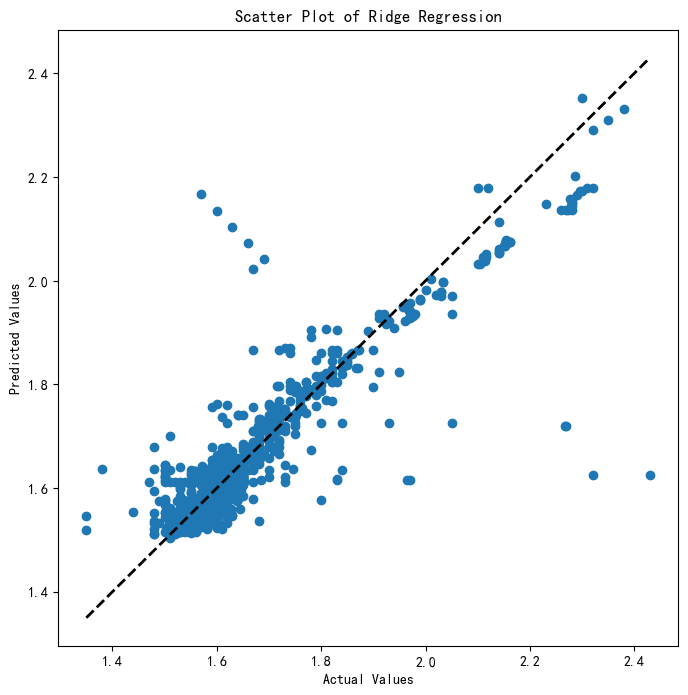

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error

# 读取Excel表格数据
df = pd.read_excel('datasets/bandgaps.xlsx')

# 提取输入特征X和目标值y
X = data.iloc[:, :5]
y = data.iloc[:, 5]

# 设置正则化参数alpha
alphas = 0.1, 0.5, 0.0000010
model = Ridge(alpha=alpha)
model.fit(X, y)
y_pred = model.predict(X)
rmse = np.sqrt(mean_squared_error(y, y_pred))
print(f'alpha={alpha}, RMSE: {rmse:.5f}')


plt.figure(figsize=(8, 8))
plt.scatter(y, y_pred)
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Scatter Plot of Ridge Regression')
plt.show()

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# 读取Excel表格数据
df = pd.read_excel('datasets/bandgaps.xlsx')

# 提取输入特征和目标值
X = data.iloc[:, :5]
y = data.iloc[:, 5]

# 使用多项式特征转换
poly = PolynomialFeatures(degree=2)
X_poly = poly.fit_transform(X)

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=42)

# 创建岭回归模型

alphas = [0.1, 1.0, 10.0]
for alpha in alphas:
    model = Ridge(alpha=alpha)
    model.fit(X, y)
    y_pred = model.predict(X)
    rmse = np.sqrt(mean_squared_error(y, y_pred))
    print(f'alpha={alpha}, RMSE: {rmse:.5f}')
# 训练模型

# 画出预测值和实际值之间的误差散点图
# plt.scatter(y_test, y_pred)
# plt.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=2)

# plt.xlabel("Actual Values")
# plt.ylabel("Predicted Values")
# plt.title("Actual vs Predicted Values")
# plt.show()

alpha=0.1, RMSE: 0.08163
alpha=1.0, RMSE: 0.08167
alpha=10.0, RMSE: 0.08198


#### lasso回归

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


均方误差（Mean Squared Error）: 0.07828455689768254


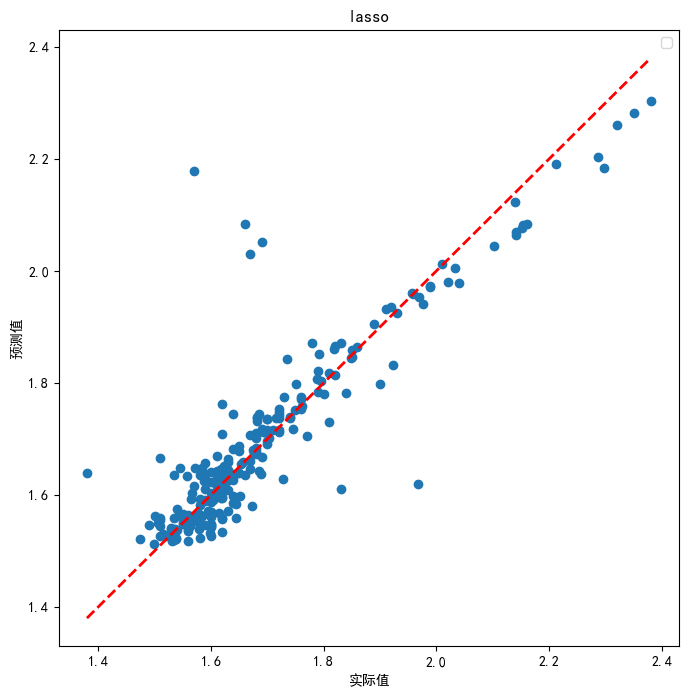

In [ ]:

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error

df = pd.read_excel('datasets/bandgaps.xlsx')

X = df.iloc[:, :5]
y = df.iloc[:, 5]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

model = Lasso(alpha=0.001)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
mse = np.sqrt(mean_squared_error(y_test, y_pred))
print("均方误差（Mean Squared Error）:", mse)
import matplotlib.pyplot as plt
plt.rcParams['font.sans-serif'] = ['SimHei']  # 指定默认字体为黑体
plt.rcParams['axes.unicode_minus'] = False  # 正常显示负号
# 绘制预测值和实际值的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()],  'r--', linewidth=2)
plt.xlabel('实际值')
plt.ylabel('预测值')
plt.title('lasso')
plt.legend()
plt.show()

Root Mean Squared Error (RMSE): 0.07704994666639153


d:\APP\anaconda\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.424e+00, tolerance: 1.182e-03
  model = cd_fast.enet_coordinate_descent(


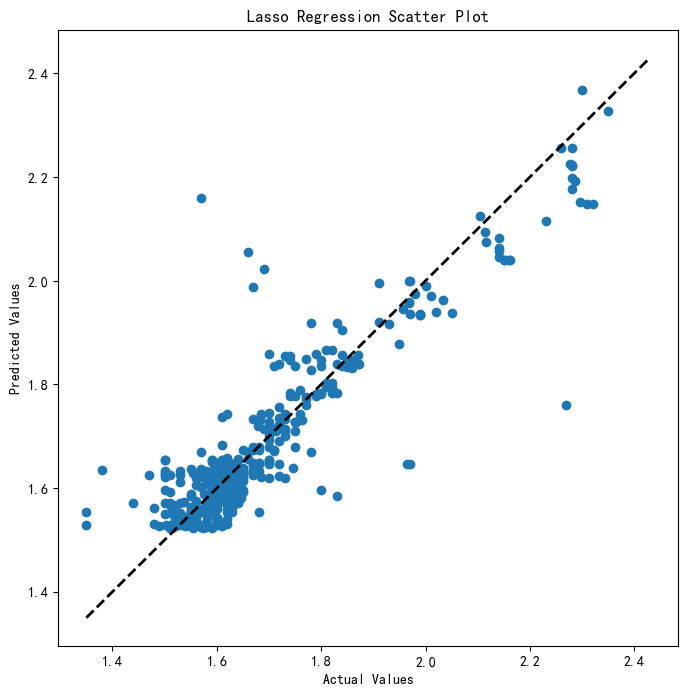

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
data = pd.read_excel('datasets/bandgap_datasets.xlsx')
X = data.iloc[:, :5]
y = data.iloc[:, 5]
poly = PolynomialFeatures(degree=2)
X_poly = poly.fit_transform(X)
X_train, X_test, y_train, y_test = train_test_split(X_poly, y, test_size=0.5, random_state=42)
model = Lasso(alpha=0.0000001)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("Root Mean Squared Error (RMSE):", rmse)
plt.figure(figsize=(8,8))
plt.scatter(y_test, y_pred)
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=2)  # 对角线
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Lasso Regression Scatter Plot")
plt.show()

#### 随机森林回归

均方误差（Mean Squared Error）: 0.003416874774275446


C:\Users\Administrator\AppData\Local\Temp\ipykernel_4248\1933321457.py:23: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k--" (-> color='k'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=3, color='red')


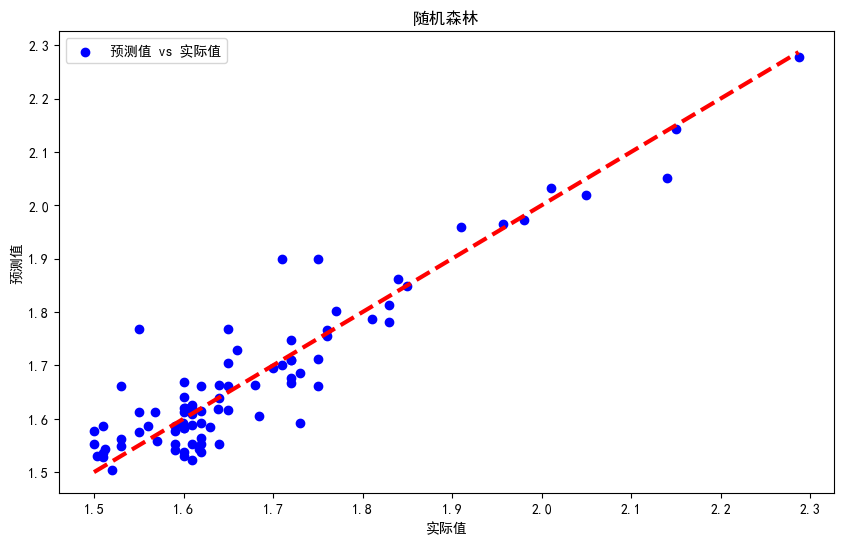

In [ ]:

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
df = pd.read_excel('datasets/bandgap_datasets.xlsx')

# df = pd.read_excel('datasets/bandgaps.xlsx')
X = df.iloc[:, :5]
y = df.iloc[:, 5]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

model = RandomForestRegressor()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print("均方误差（Mean Squared Error）:", mse)
import matplotlib.pyplot as plt
plt.rcParams['font.sans-serif'] = ['SimHei']  # 指定默认字体为黑体
plt.rcParams['axes.unicode_minus'] = False  # 正常显示负号
# 绘制预测值和实际值的偏差图
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='预测值 vs 实际值')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=3, color='red')
plt.xlabel('实际值')
plt.ylabel('预测值')
plt.title('随机森林')
plt.legend()
plt.show()

Root Mean Squared Error (RMSE): 0.09572


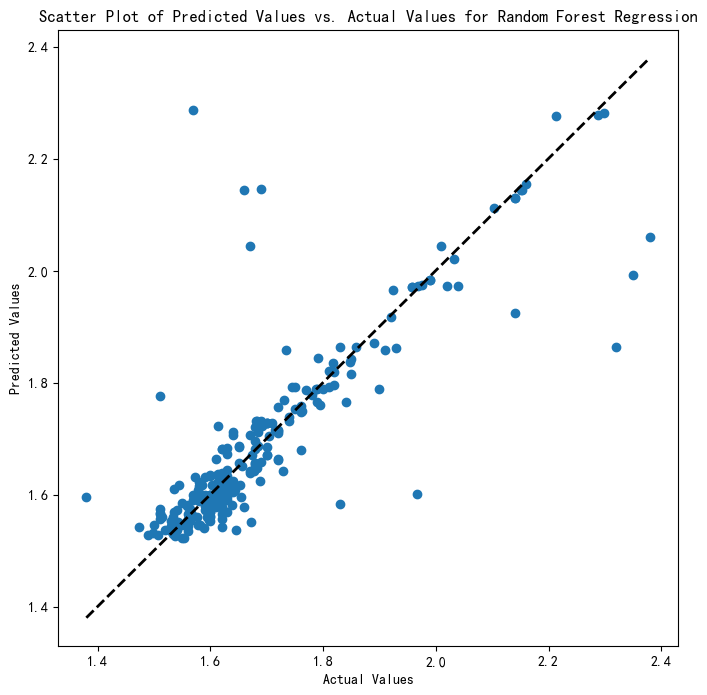

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# 读取Excel表格数据
data = pd.read_excel('datasets/bandgaps.xlsx')

# 提取输入特征X和目标值y
X = data.iloc[:, :5]
y = data.iloc[:, 5]

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 设置随机森林的参数
n_estimators = 10
max_depth = None
min_samples_split = 2
min_samples_leaf = 1

# 初始化随机森林回归模型
model = RandomForestRegressor(n_estimators=n_estimators,
                              max_depth=max_depth,
                              min_samples_split=min_samples_split,
                              min_samples_leaf=min_samples_leaf,
                              random_state=42)

# 使用训练集数据拟合模型
model.fit(X_train, y_train)

# 在测试集上进行预测
y_pred = model.predict(X_test)

# 计算均方根误差(RMSE)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Root Mean Squared Error (RMSE): {rmse:.5f}')

# 绘制随机森林回归的散点图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Scatter Plot of Predicted Values vs. Actual Values for Random Forest Regression')
plt.show()

#### 支持向量机回归

均方误差（Mean Squared Error）: 0.07901299412192965


C:\Users\Administrator\AppData\Local\Temp\ipykernel_4248\3062601325.py:28: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--" (-> color='r'). The keyword argument will take precedence.
  plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=3, color='red')


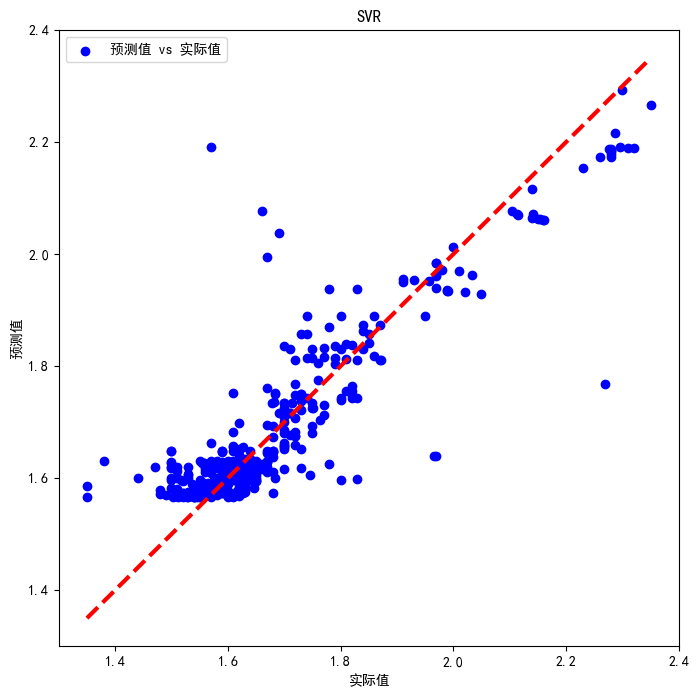

In [ ]:

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
df = pd.read_excel('datasets/bandgap_datasets.xlsx')

# df = pd.read_excel('datasets/bandgaps.xlsx')
X = df.iloc[:, :5]
y = df.iloc[:, 5]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

model = SVR()

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

mse = np.sqrt(mean_squared_error(y_test, y_pred))
print("均方误差（Mean Squared Error）:", mse)

import matplotlib.pyplot as plt
plt.rcParams['font.sans-serif'] = ['SimHei']  # 指定默认字体为黑体
plt.rcParams['axes.unicode_minus'] = False  # 正常显示负号
# 绘制预测值和实际值的偏差图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, color='blue', label='预测值 vs 实际值')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=3, color='red')
plt.xlabel('实际值')
plt.ylabel('预测值')
plt.title('SVR')
plt.legend()
plt.show()


Root Mean Squared Error (RMSE): 0.08392


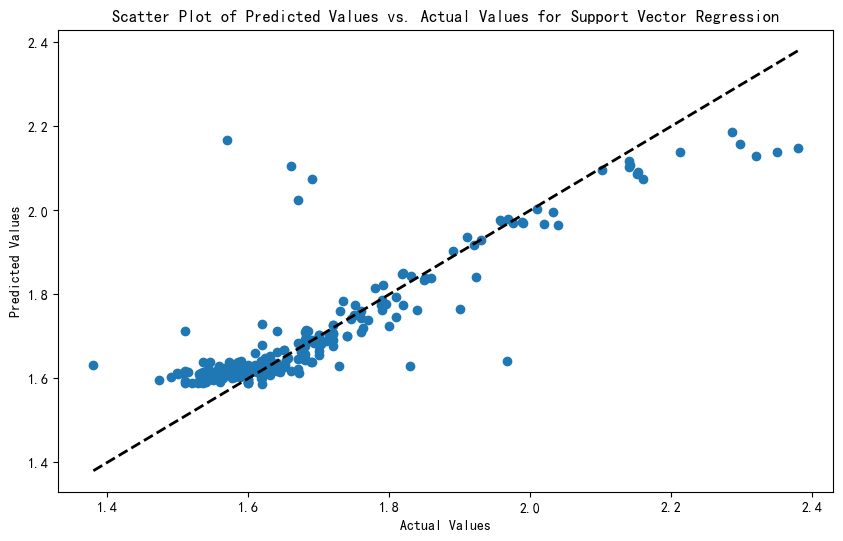

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# 读取Excel表格数据
data = pd.read_excel('datasets/bandgaps.xlsx')

# 提取输入特征X和目标值y
X = data.iloc[:, :5]
y = data.iloc[:, 5]

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

# 设置支持向量机回归的参数
kernel = 'rbf'
C = 0.09
epsilon = 0.1

# 初始化支持向量机回归模型
model = SVR(kernel=kernel, C=C, epsilon=epsilon)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Root Mean Squared Error (RMSE): {rmse:.5f}')
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Scatter Plot of Predicted Values vs. Actual Values for Support Vector Regression')
plt.show()

Mean squared error: 0.00586086977300198


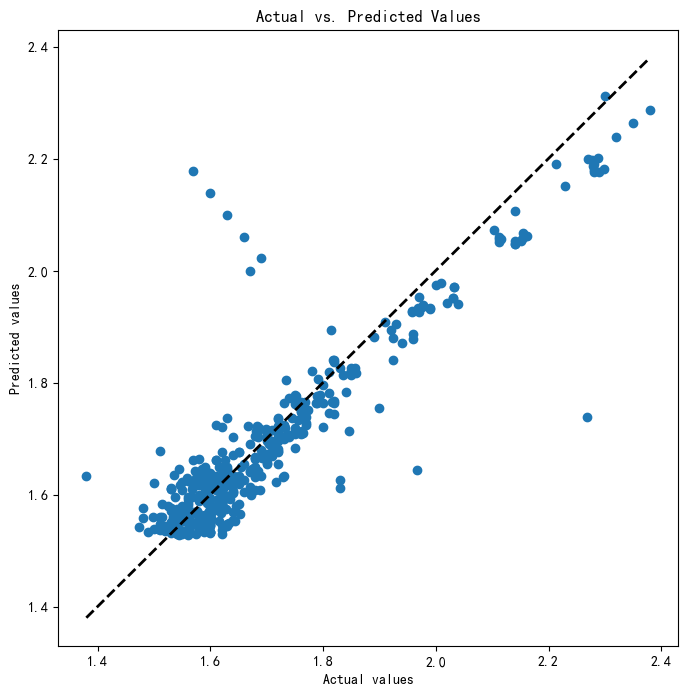

In [ ]:
import numpy as np
import pandas as pd
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Load the data
data = pd.read_excel('datasets/bandgaps.xlsx')

# Split the data into features and target
X = data.iloc[:, :5]
y = data.iloc[:, 5]

# Scale the features
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Define the grid of hyperparameters to search
param_grid = {'C': [0.1, 1, 10, 100], 'kernel': ['linear', 'rbf'], 'gamma': [0.1, 0.01, 0.001]}

# Create the support vector regression model
svr = SVR()

# Perform grid search cross-validation
grid_search = GridSearchCV(svr, param_grid, cv=5)
grid_search.fit(X, y)

# Get the best model
best_model = grid_search.best_estimator_

# Predict the target values
y_pred = best_model.predict(X)

# Calculate the mean squared error
mse = mean_squared_error(y, y_pred)
print("Mean squared error:", mse)

# Plot the actual and predicted values
plt.figure(figsize=(8, 8))
plt.scatter(y, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel("Actual values")
plt.ylabel("Predicted values")
plt.title("Actual vs. Predicted Values")
plt.show()

RMSE: 0.06638


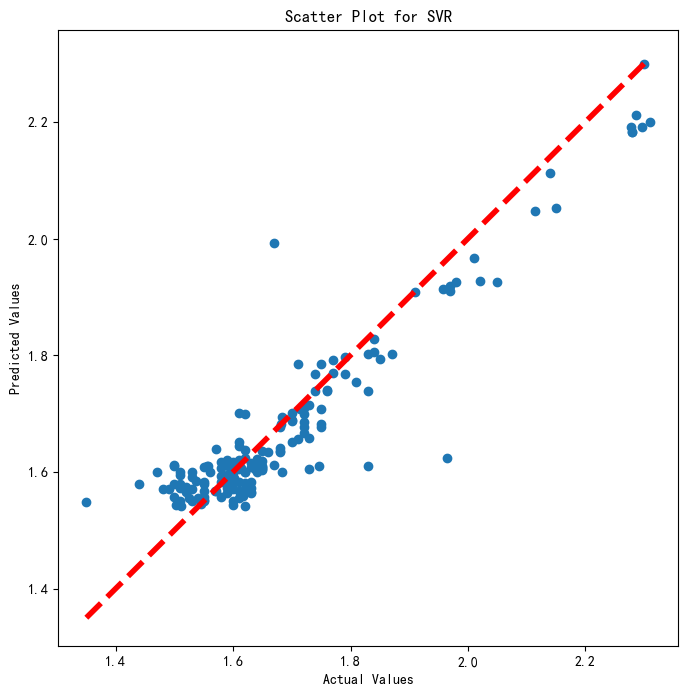

In [ ]:
import numpy as np
import pandas as pd
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

df = pd.read_excel('datasets/bandgap_datasets.xlsx')
X = df.iloc[:, :5]
y = df.iloc[:, 5]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
param_grid = {'C': [0.000001, 0.1, 1, 10], 'gamma': [0.000001, 0.1, 1, 10]}
svr = SVR()
grid_search = GridSearchCV(svr, param_grid, cv=5)
grid_search.fit(X_train, y_train)
best_params = grid_search.best_params_
model = SVR(C=best_params['C'], gamma=best_params['gamma'])
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'RMSE: {rmse:.5f}')
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=4)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Scatter Plot for SVR')
plt.show()


RMSE: 0.08131


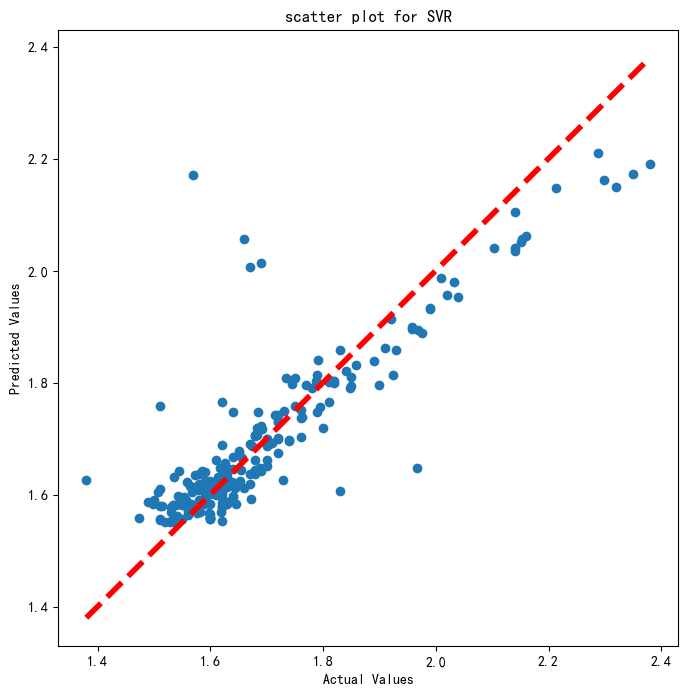

In [ ]:
import numpy as np
import pandas as pd
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from skopt import BayesSearchCV

# 1. 读取Excel数据
df = pd.read_excel('datasets/bandgap_datasets.xlsx')
X = df.iloc[:, :5]  # 输入特征
y = df.iloc[:, 5]   # 目标值

# 2. 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

# 3. 使用贝叶斯优化搜索超参数
param_space = {
    'C': (0.1, 10, 'log-uniform'),
    'gamma': (0.1, 10, 'log-uniform')
}
svr = SVR()
optimizer = BayesSearchCV(svr, param_space, n_iter=20, cv=2, scoring='neg_mean_squared_error', random_state=2)
optimizer.fit(X_train, y_train)
best_params = optimizer.best_params_
model = SVR(C=best_params['C'], gamma=best_params['gamma'])
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'RMSE: {rmse:.5f}')
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=4)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('scatter plot for SVR')
plt.show()

0:	learn: 0.1793394	total: 524us	remaining: 523ms
1:	learn: 0.1780828	total: 1.16ms	remaining: 580ms
2:	learn: 0.1770565	total: 1.56ms	remaining: 520ms
3:	learn: 0.1758513	total: 1.94ms	remaining: 483ms
4:	learn: 0.1747497	total: 2.36ms	remaining: 470ms
5:	learn: 0.1737195	total: 2.76ms	remaining: 457ms
6:	learn: 0.1726345	total: 3.14ms	remaining: 446ms
7:	learn: 0.1715193	total: 3.56ms	remaining: 441ms
8:	learn: 0.1702453	total: 3.91ms	remaining: 431ms
9:	learn: 0.1690394	total: 4.33ms	remaining: 429ms
10:	learn: 0.1678858	total: 4.77ms	remaining: 429ms
11:	learn: 0.1667316	total: 5.18ms	remaining: 427ms
12:	learn: 0.1656027	total: 5.63ms	remaining: 427ms
13:	learn: 0.1645027	total: 6.02ms	remaining: 424ms
14:	learn: 0.1633768	total: 6.5ms	remaining: 427ms
15:	learn: 0.1623148	total: 6.92ms	remaining: 426ms
16:	learn: 0.1613767	total: 7.36ms	remaining: 426ms
17:	learn: 0.1603388	total: 7.77ms	remaining: 424ms
18:	learn: 0.1592632	total: 8.18ms	remaining: 422ms
19:	learn: 0.1582839	tot

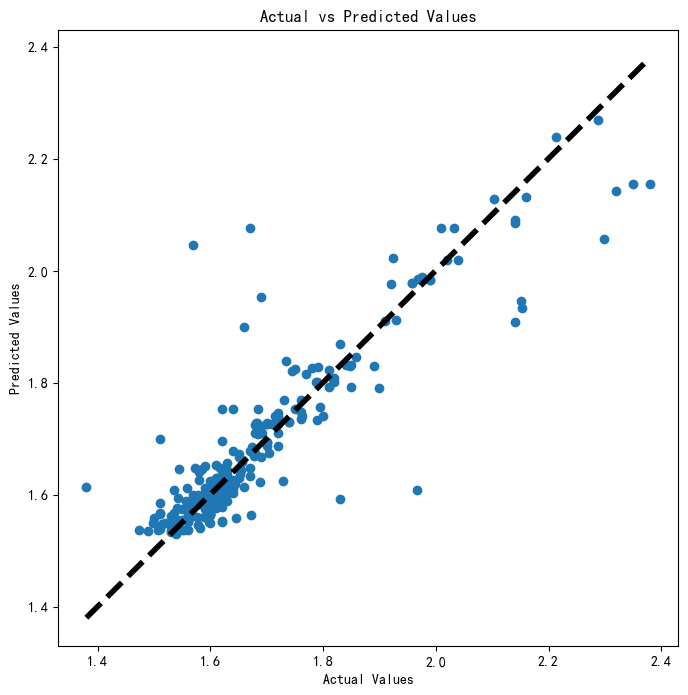

In [ ]:
import numpy as np
import pandas as pd
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# 1. 读取Excel数据
df = pd.read_excel('datasets/bandgaps.xlsx')
X = df.iloc[:, :5]  # 输入特征
y = df.iloc[:, 5]   # 目标值

# 2. 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

# 3. 使用网格搜索优化超参数
param_grid = {
    'depth': [4, 6, 8],
    'learning_rate': [0.01, 0.05, 0.1],
    'l2_leaf_reg': [1, 3, 5]
}
model = CatBoostRegressor(random_state=42)
grid_search = GridSearchCV(model, param_grid, cv=2)
grid_search.fit(X_train, y_train)
best_params = grid_search.best_params_

# 4. 使用最佳超参数训练模型
model = CatBoostRegressor(depth=best_params['depth'],
                         learning_rate=best_params['learning_rate'],
                         l2_leaf_reg=best_params['l2_leaf_reg'],
                         random_state=42)
model.fit(X_train, y_train)

# 5. 评估模型在测试集上的性能
y_pred = model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'RMSE: {rmse:.5f}')

# 6. 绘制预测值和实际值的散点图
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=4)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Actual vs Predicted Values')
plt.show()

### KNN回归

Root Mean Squared Error (RMSE): 0.08597


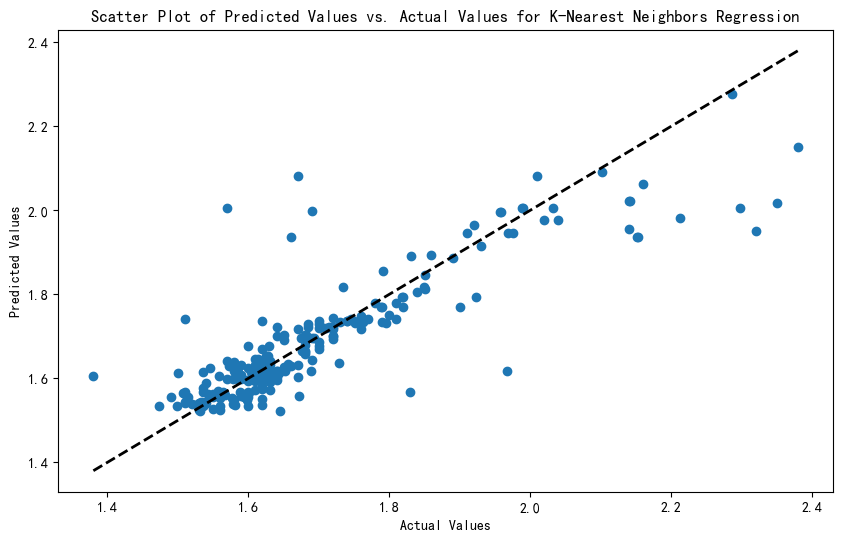

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# 读取Excel表格数据
data =  pd.read_excel('datasets/bandgaps.xlsx')

# 提取输入特征X和目标值y
X = data.iloc[:, :5]
y = data.iloc[:, 5]

# 划分训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

# 设置K近邻回归的参数
n_neighbors = 5
weights = 'uniform'
algorithm = 'auto'

# 初始化K近邻回归模型
model = KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, algorithm=algorithm)

# 使用训练集数据拟合模型
model.fit(X_train, y_train)

# 在测试集上进行预测
y_pred = model.predict(X_test)

# 计算均方根误差(RMSE)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Root Mean Squared Error (RMSE): {rmse:.5f}')

# 绘制K近邻回归的散点图
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Scatter Plot of Predicted Values vs. Actual Values for K-Nearest Neighbors Regression')
plt.show()

### 决策树回归

Root Mean Squared Error (RMSE): 0.12408


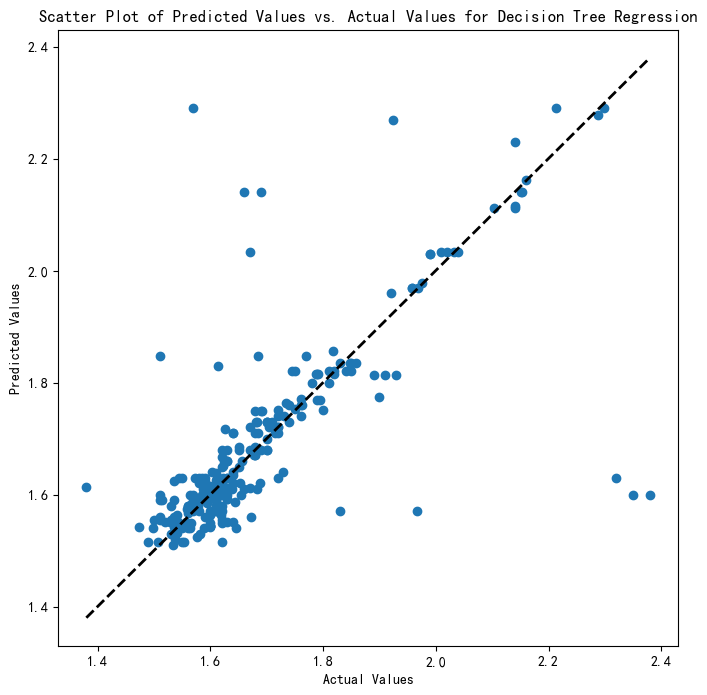

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# 读取Excel表格数据
data = pd.read_excel('datasets/bandgaps.xlsx')
X = data.iloc[:, :5]
y = data.iloc[:, 5]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)
max_depth = None
min_samples_split = 2
min_samples_leaf = 1
model = DecisionTreeRegressor(max_depth=max_depth,
                              min_samples_split=min_samples_split,
                              min_samples_leaf=min_samples_leaf,
                              random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Root Mean Squared Error (RMSE): {rmse:.5f}')
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Scatter Plot of Predicted Values vs. Actual Values for Decision Tree Regression')
plt.show()

### 神经网络

C:\Users\Administrator\AppData\Roaming\Python\Python311\site-packages\keras\src\layers\core\dense.py:85: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
RMSE: 0.27989


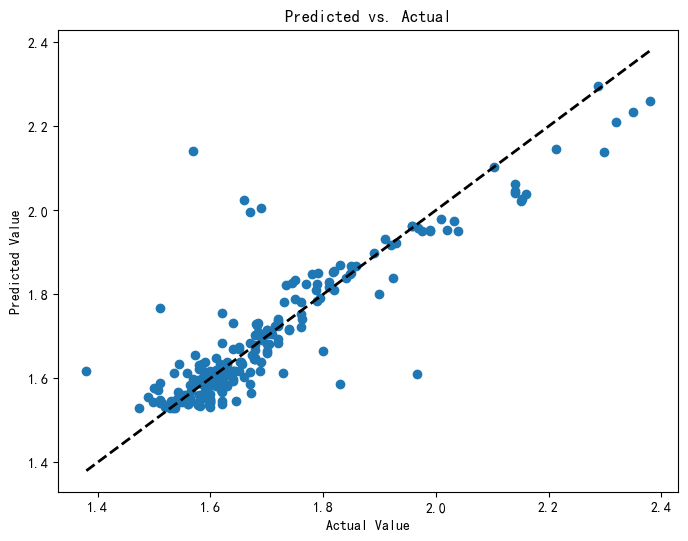

In [ ]:
import pandas as pd
from keras.models import Sequential
from keras.layers import Dense
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# 读取Excel数据
df = pd.read_excel('datasets/bandgaps.xlsx')

# 提取输入特征和目标值
X = df.iloc[:, :5]
y = df.iloc[:, 5]

model = Sequential()
model.add(Dense(64, activation='relu', input_shape=(5,)))
model.add(Dense(32, activation='relu'))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mean_squared_error')
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)
model.fit(X_train, y_train, epochs=50, batch_size=16, verbose=0)
y_pred = model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred, squared=False))
print(f'RMSE: {rmse:.5f}')
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual Value')
plt.ylabel('Predicted Value')
plt.title('Predicted vs. Actual')
plt.show()

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor

df = pd.read_excel('bandgap.xlsx')

X = df.iloc[:, :5]
y = df.iloc[:, 5]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

# alpha = 1.0
# model = Ridge(alpha=alpha)
# model = SVR()
model = RandomForestRegressor()
model.fit(X_train, y_train)


df_new = pd.read_excel('test.xlsx')

X_new = df_new.iloc[:, :5]

y_pred_new = model.predict(X_new)

df_new['Bandgap(eV)'] = y_pred_new

df_new.to_excel('predicted_results.xlsx', index=False)